In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, davies_bouldin_score
from datetime import datetime

In [2]:
%matplotlib inline

In [24]:
df = pd.read_csv('./origin_dataset.csv', encoding='utf-8').drop(columns=['Unnamed: 0'])
df.iloc[:,20:35].describe()

,j_edu_15 with Elementary School Education,j_edu_15 with Self-Taught Education,j_edu_15 who are Illiterate,c_marrital_15 who are Unmarried,c_marrital_15 who are Married,c_marrital_15 who are Divorced,c_popcal_Natural Increase,c_popcal_Social Increase,c_popcal_Total Number of Households,j_income_Total Comprehensive Income,j_income_Average Comprehensive Income,j_income_Median Comprehensive Income,j_income_Comprehensive Income Q1,j_income_Comprehensive Income Q3,j_income_Comprehensive Income std
count,7440.000000,7440.000000,7440.000000,7440.000000,7440.000000,7440.000000,7440.000000,7440.000000,7440.000000,7.440000e+03,7440.000000,7440.000000,7440.000000,7440.00000,7440.000000
mean,328.320430,7.079301,24.025269,1695.451478,1984.415726,333.625000,7.654032,-13.310215,1760.606452,1.356909e+06,898.545027,574.998790,312.200134,1073.15000,1522.823411
std,171.255319,5.067885,15.809855,1043.752402,1176.537941,200.860774,18.569929,136.719197,1047.066637,1.202628e+06,387.971045,149.888371,89.076400,328.43089,5202.124066
min,20.000000,0.000000,0.000000,27.000000,70.000000,12.000000,-80.000000,-2217.000000,44.000000,0.000000e+00,0.000000,0.000000,0.000000,0.00000,0.000000
25%,202.000000,3.000000,13.000000,968.750000,1158.750000,205.000000,-4.000000,-56.000000,1054.000000,5.586928e+05,685.000000,473.000000,224.000000,845.00000,687.565000
50%,307.500000,6.000000,21.000000,1590.500000,1889.500000,309.000000,5.000000,-19.000000,1672.000000,1.059944e+06,823.000000,570.000000,345.000000,1013.50000,920.355000
75%,427.250000,10.000000,31.000000,2248.000000,2624.000000,432.000000,16.000000,6.000000,2311.250000,1.830338e+06,1024.000000,663.000000,382.000000,1253.00000,1373.497500
max,1228.000000,40.000000,150.000000,10297.000000,12330.000000,1952.000000,233.000000,3907.000000,11710.000000,1.339890e+07,9253.000000,1209.000000,880.000000,2610.00000,271373.380000


In [25]:
temp = pd.read_csv('./origin_dataset.csv', encoding='utf-8').drop(columns=['Unnamed: 0'])
temp.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7440 entries, 0 to 7439
Data columns (total 96 columns):
 #   Column                                            Non-Null Count  Dtype  
---  ------                                            --------------  -----  
 0   Year                                              7440 non-null   int64  
 1   County Name                                       7440 non-null   object 
 2   Township Name                                     7440 non-null   object 
 3   Village Name                                      7440 non-null   object 
 4   c_pop_Population                                  7440 non-null   int64  
 5   c_ratio_Sex Ratio                                 7440 non-null   float64
 6   c_popcal_Population Density                       7440 non-null   float64
 7   c_ratio_Dependency Ratio                          7440 non-null   float64
 8   c_ratio_Child Dependency Ratio                    7440 non-null   float64
 9   c_ratio_Elderly Dep

## Feature Selection

In [146]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7440 entries, 0 to 7439
Data columns (total 73 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   Year                                 7440 non-null   int64  
 1   County Name                          7440 non-null   object 
 2   Township Name                        7440 non-null   object 
 3   Village Name                         7440 non-null   object 
 4   c_pop                                7440 non-null   float64
 5   c_ratio_Sex Ratio                    7440 non-null   float64
 6   c_popcal_Population Density          7440 non-null   float64
 7   c_ratio_Dependency Ratio             7440 non-null   float64
 8   c_ratio_Child Dependency Ratio       7440 non-null   float64
 9   c_ratio_Elderly Dependency Ratio     7440 non-null   float64
 10  c_ratio_Aging Index                  7440 non-null   float64
 11  c_popcal_Natural Increase     

In [67]:
# ref https://stackoverflow.com/questions/39216897/plot-pca-loadings-and-loading-in-biplot-in-sklearn-like-rs-autoplot
def myplot(score,coeff,labels=None):
    xs = score[:,0]
    ys = score[:,1]
    n = coeff.shape[0]
    scalex = 1.0/(xs.max() - xs.min())
    scaley = 1.0/(ys.max() - ys.min())
    plt.scatter(xs * scalex,ys * scaley)
    for i in range(n):
        plt.arrow(0, 0, coeff[i,0], coeff[i,1],color = 'r',alpha = 0.5)
        if labels is None:
            plt.text(coeff[i,0]* 1.15, coeff[i,1] * 1.15, "Var"+str(i+1), color = 'g', ha = 'right', va = 'center')
        else:
            plt.text(coeff[i,0]* 1.2, coeff[i,1] * 1.15, labels[i], color = 'black', ha = 'center', va = 'baseline')
    plt.xlim(-0.3,1)
    plt.ylim(-0.9,0.9)
    plt.xlabel("PC{}".format(1))
    plt.ylabel("PC{}".format(2))
    plt.title('Biplot')
    plt.grid()

In [78]:
def plotsct(x, j,name):
    test = x.reset_index(drop=True)
    a = 1
    if pca.fit_transform(x).shape[1]==2:
        test[['edu1', 'edu2']]=pca.fit_transform(x)
        fig = plt.figure(figsize=(20, 17))
        
        for i in x.columns:
            plt.subplot(330+a)
            
            sns.scatterplot(data=test, x='edu1', y='edu2', hue=i)
            plt.title(name[a-1])
            a+=1         
    else:
        fig = plt.figure(figsize=(18, 5))
        
        test['pca_result'] = pca.fit_transform(x)
        for i in x.columns:
            plt.subplot(440+a)
            
            sns.scatterplot(data=test, x='pca_result', y=i)
            plt.title(i+' pca result')
            a+=1    
    plt.tight_layout()
    
    plt.show()


# edu plot (pca)

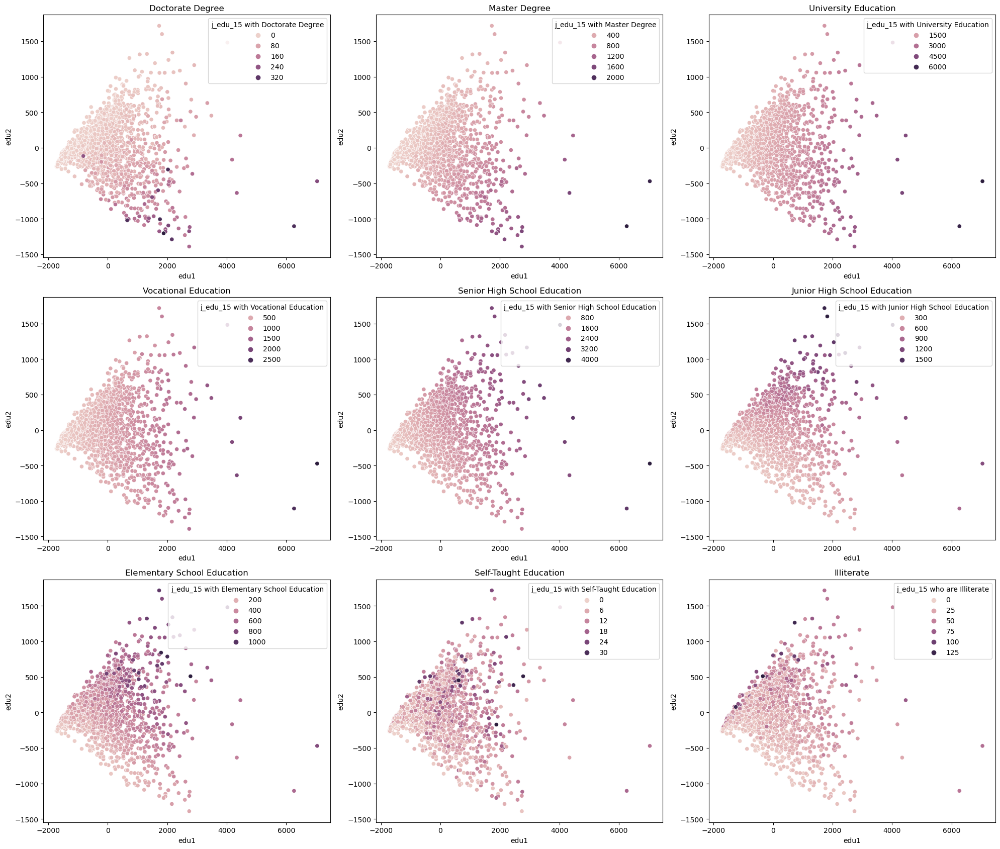

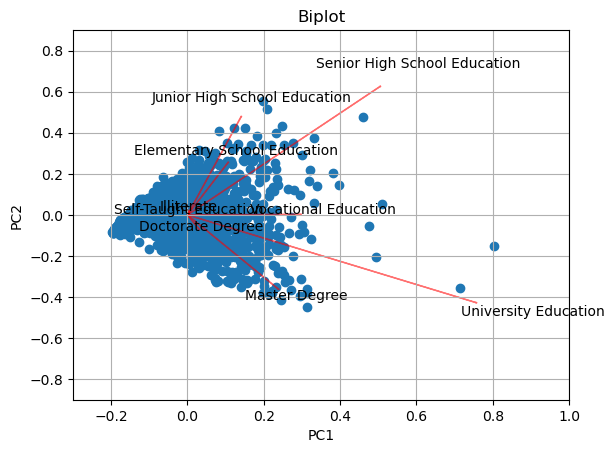

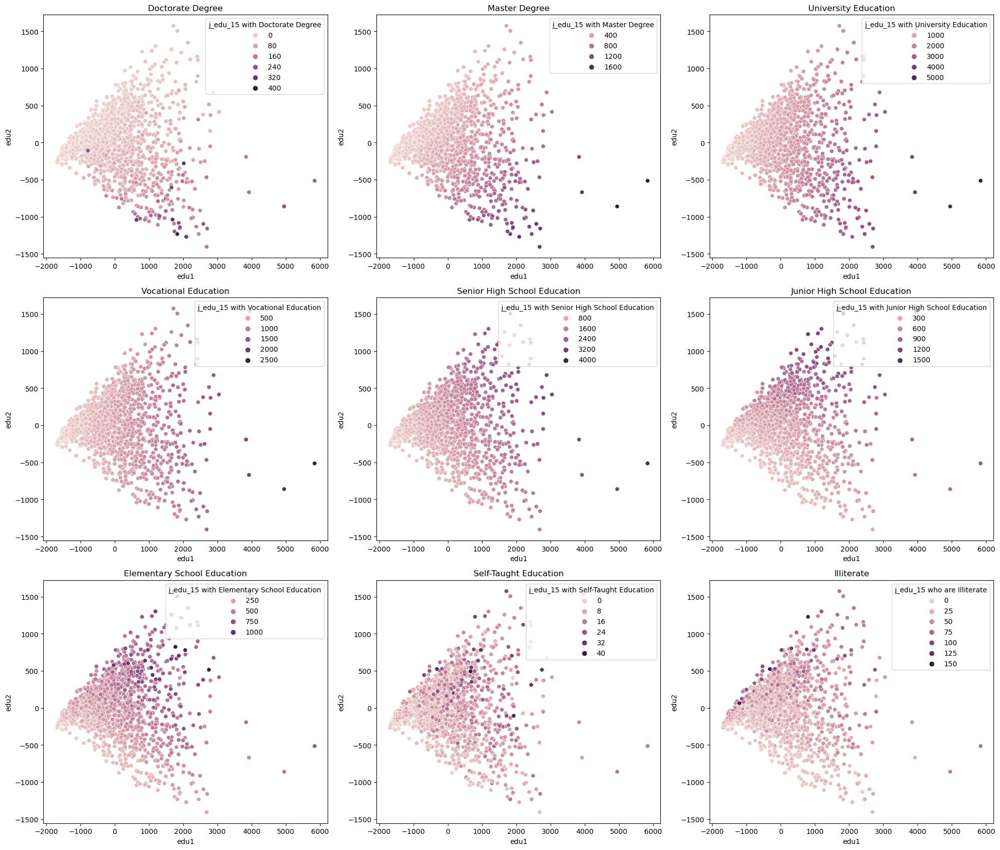

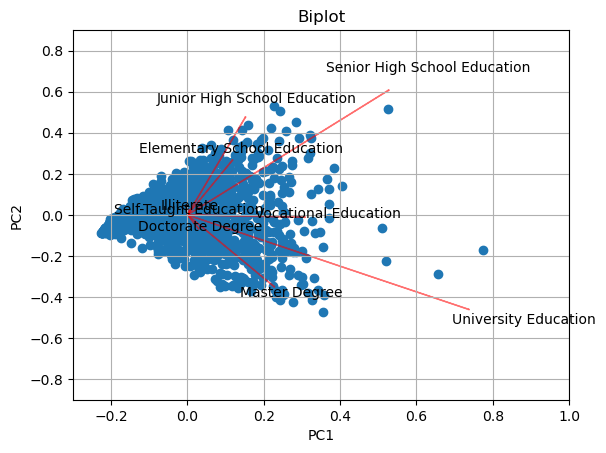

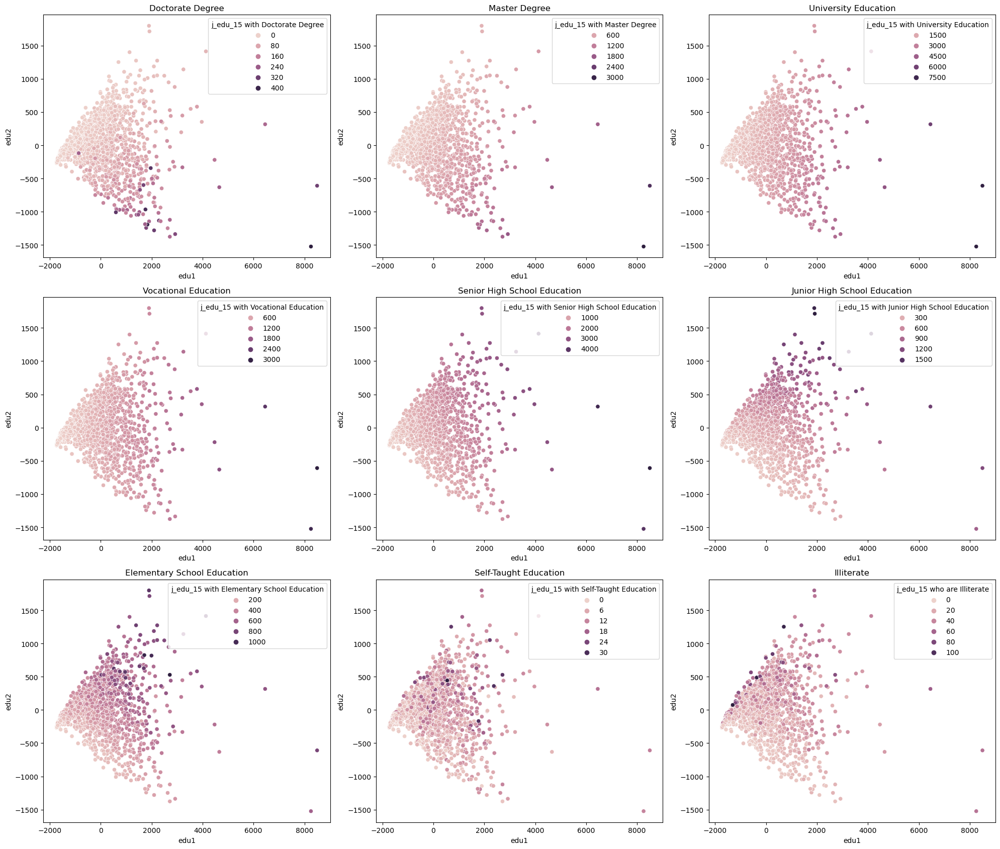

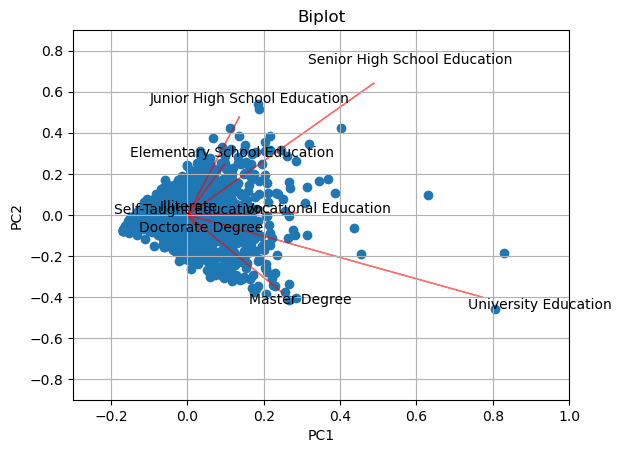

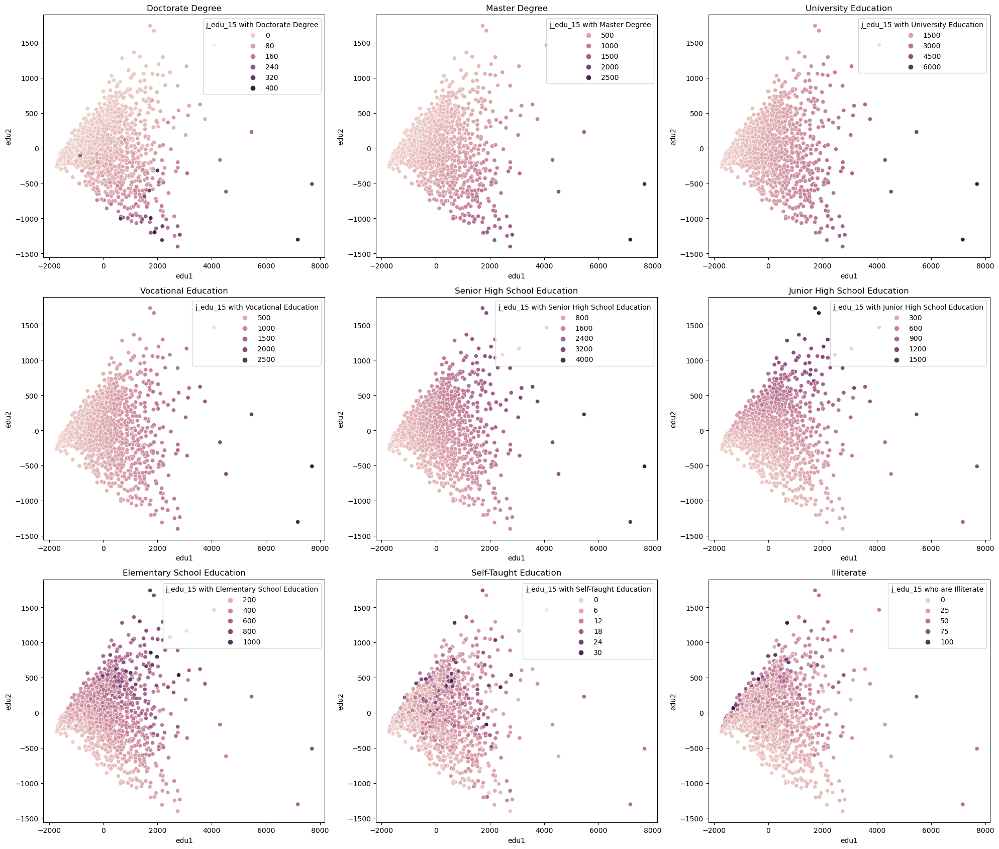

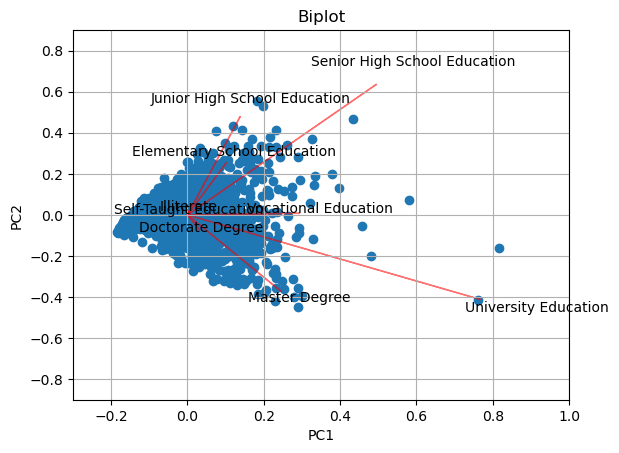

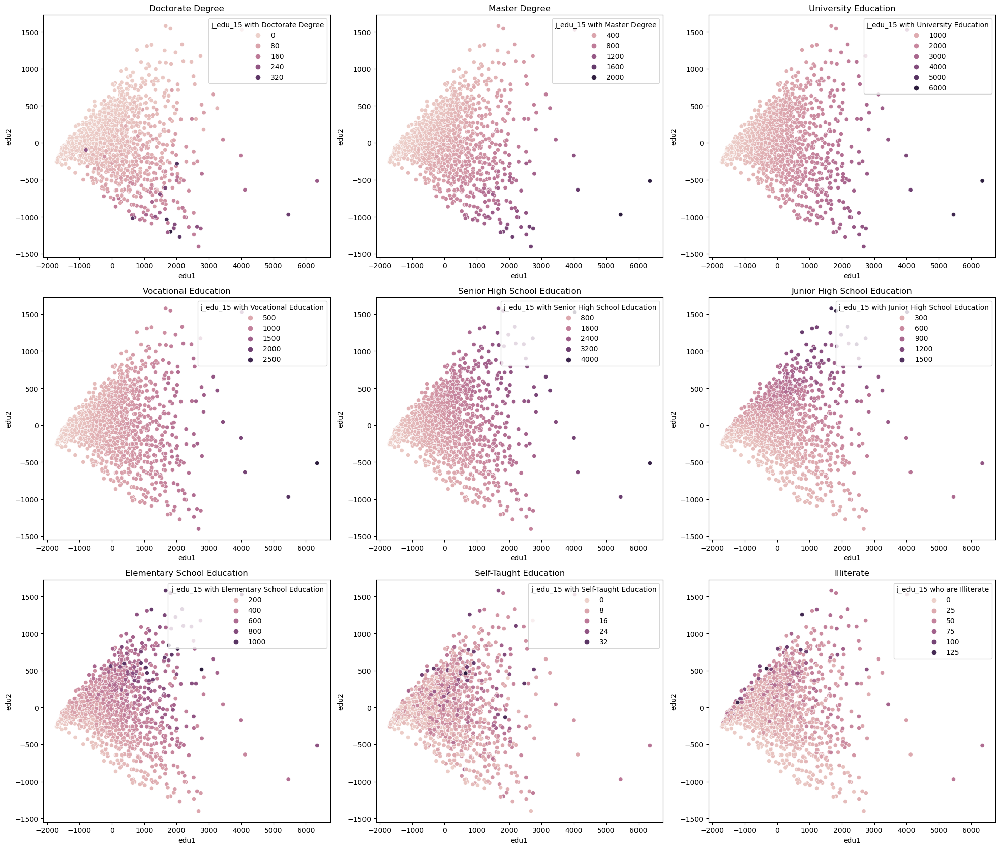

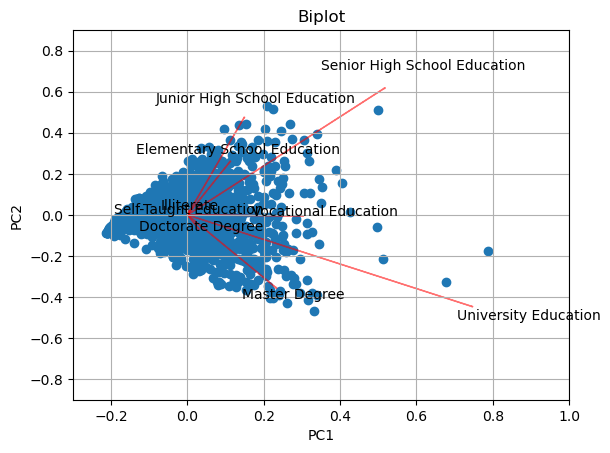

In [71]:
name = ['Doctorate Degree', 'Master Degree',
       'University Education',
       'Vocational Education',
       'Senior High School Education',
       'Junior High School Education',
       'Elementary School Education',
       'Self-Taught Education', 'Illiterate']

for i in [107, 105, 109, 108, 106]: # 
    
    x = df[df['Year']==i].filter(regex='j_edu')
    pca = PCA(2).fit(x)
    plotsct(x, i, name)
    
    #Call the function. Use only the 2 PCs.
    myplot(pca.fit_transform(x), np.transpose(pca.components_[0:2, :]), labels=name)
    plt.show()

c_pop_
h_Median
j_income
j_edu
c_marrital
c_ratio


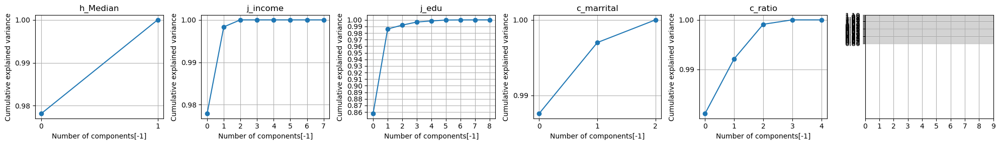

c_pop_
h_Median
j_income
j_edu
c_marrital
c_ratio


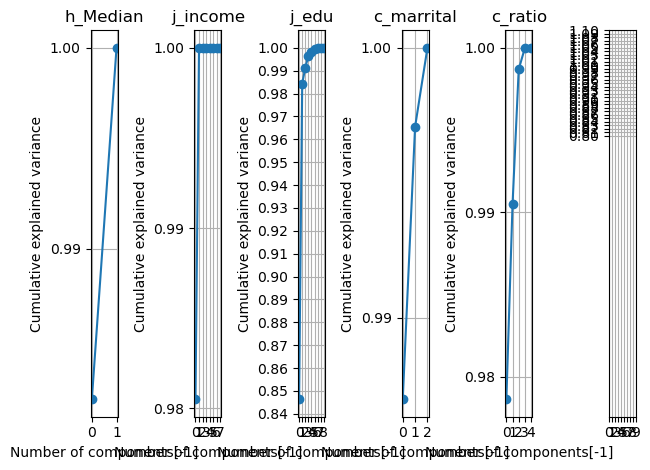

c_pop_
h_Median
j_income
j_edu
c_marrital
c_ratio


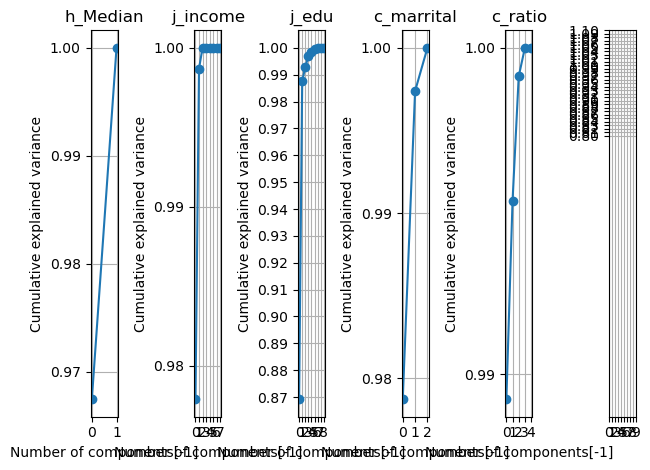

c_pop_
h_Median
j_income
j_edu
c_marrital
c_ratio


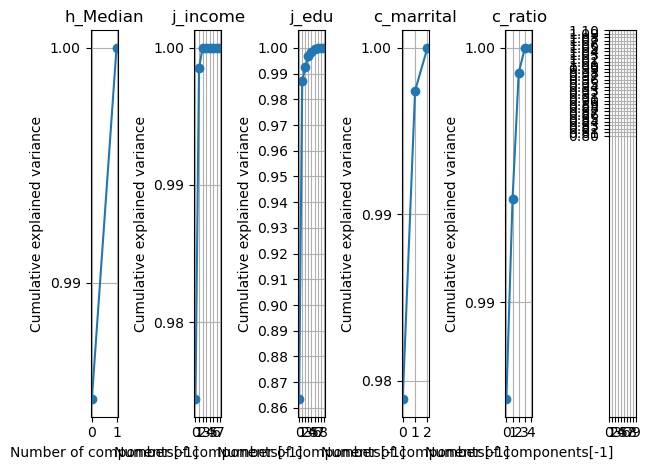

c_pop_
h_Median
j_income
j_edu
c_marrital
c_ratio


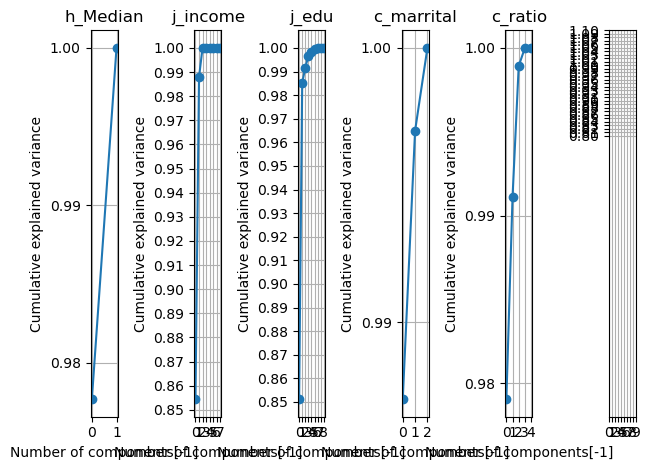

In [48]:
from sklearn.decomposition import PCA

reg = {'c_pop_':1, 'h_Median':1, 'j_income':1, 'j_edu':2, 'c_marrital':1, 'c_ratio':1}
fig = plt.figure(figsize=(20, 3))
for i in [107, 105, 109, 108, 106]:
    a = 1
    for key in reg:
        x = df[df['Year']==i].filter(regex=key)
        pca = PCA().fit(x)
        print(key)
        plt.plot(np.cumsum(pca.explained_variance_ratio_), marker='o')
        plt.title(key)
        plt.xlabel('Number of components[-1]')
        plt.ylabel('Cumulative explained variance')
        plt.subplot(160+a)
        plt.xticks(np.arange(0, 10, step=1))
        plt.yticks(np.arange(0.8, 1.1, step=0.01))
        plt.grid(True)
        a+=1
    
    plt.tight_layout()
    plt.show()
        


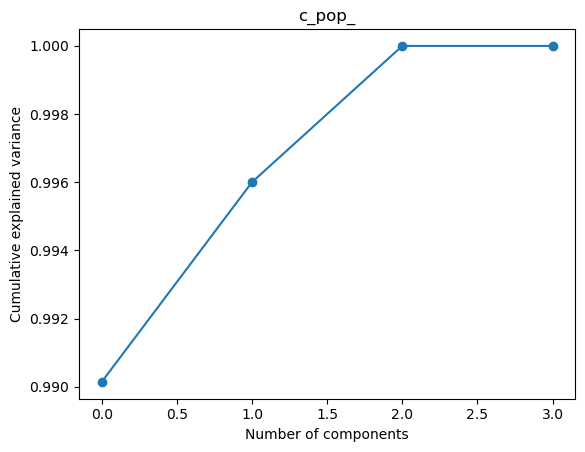

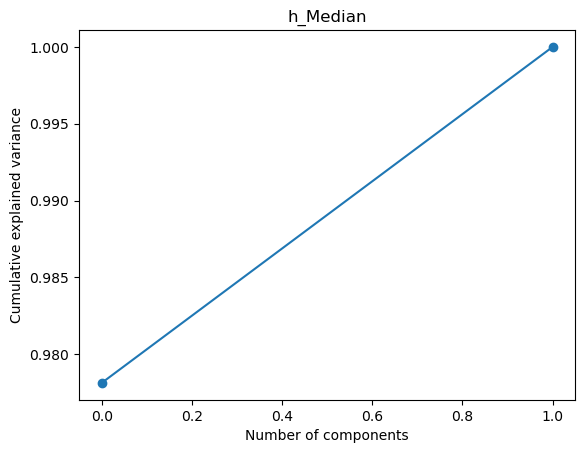

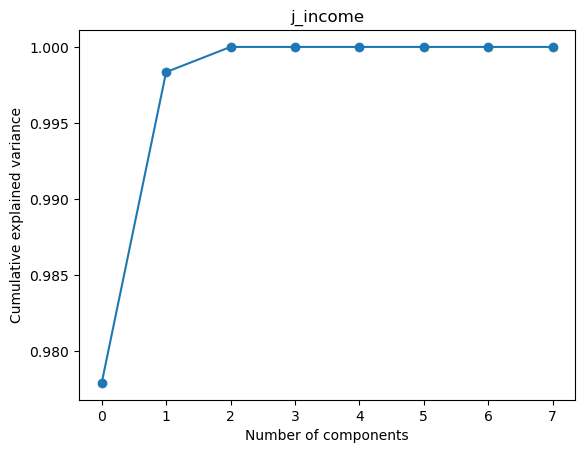

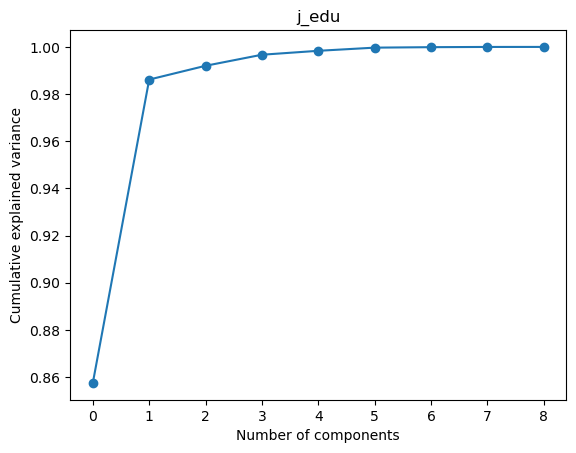

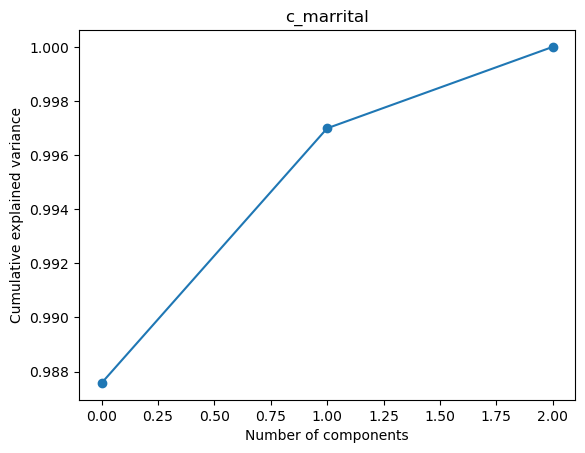

...

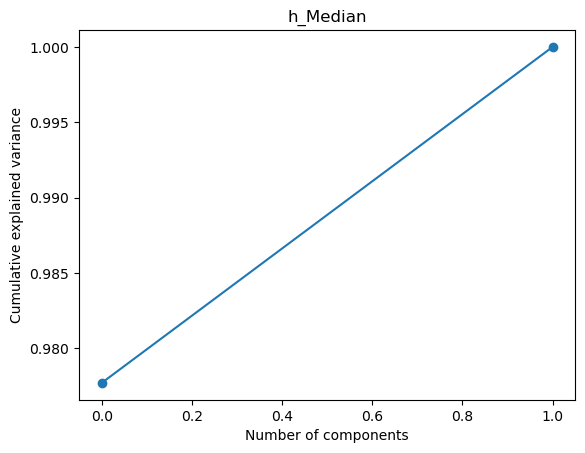

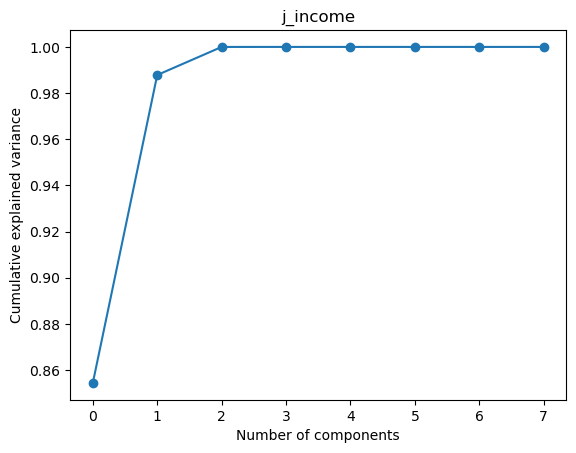

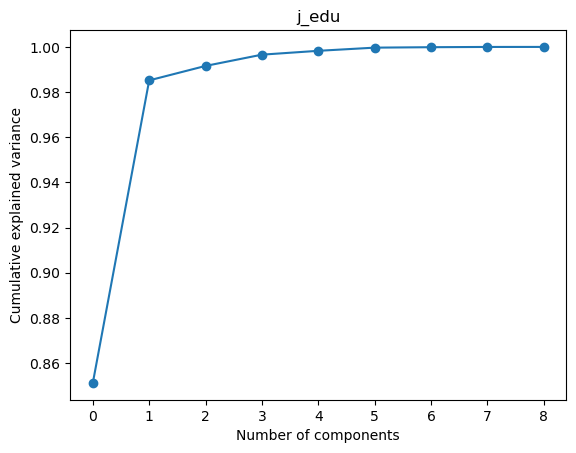

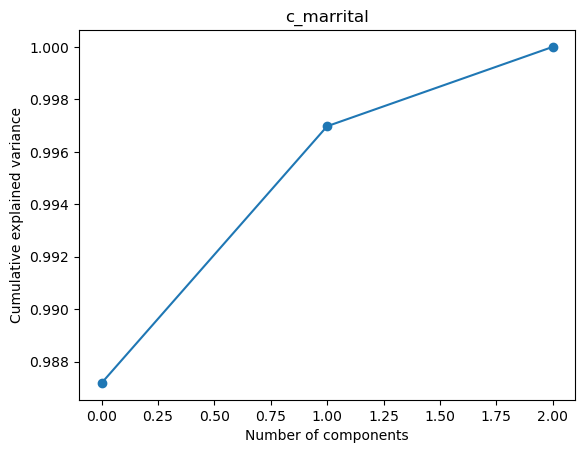

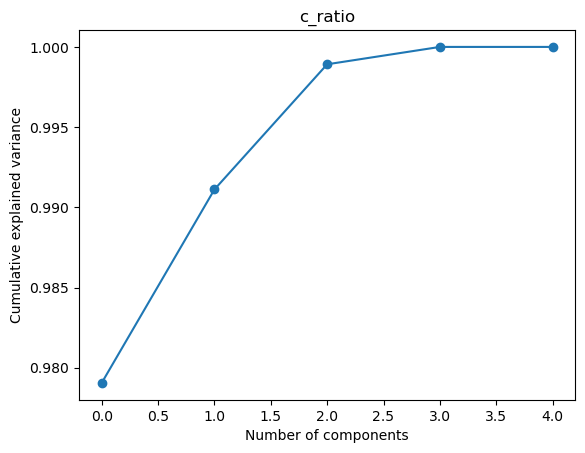

In [16]:
from sklearn.decomposition import PCA
a = []
b = []
c = []
d, d1 = [], []
e, f = [], []
name = ['Doctorate Degree', 'Master Degree',
       'University Education',
       'Vocational Education',
       'Senior High School Education',
       'Junior High School Education',
       'Elementary School Education',
       'Self-Taught Education', 'Illiterate']
reg = {'c_pop_':1, 'h_Median':1, 'j_income':1, 'j_edu':2, 'c_marrital':1, 'c_ratio':1}
for i in [107, 105, 109, 108, 106]:
    for key in reg:
        x = df[df['Year']==i].filter(regex=key)
        pca = PCA().fit(x)
        plt.plot(np.cumsum(pca.explained_variance_ratio_), marker='o')
        plt.xlabel('Number of components')
        plt.ylabel('Cumulative explained variance')
        plt.title(key)
        plt.show()
        
        pca = PCA(reg[key]).fit(x)
        if key == 'c_pop_':
            a.append(pd.DataFrame(pca.transform(x))[0].values.tolist())
        elif key == 'h_Median':
            b.append(pd.DataFrame(pca.transform(x))[0].values.tolist())
        elif key == 'j_edu':
            d.append(pd.DataFrame(pca.transform(x))[0].values.tolist())
            d1.append(pd.DataFrame(pca.transform(x))[1].values.tolist())
        elif key == 'c_marrital':
            e.append(pd.DataFrame(pca.transform(x))[0].values.tolist())
        elif key == 'c_ratio':
            f.append(pd.DataFrame(pca.transform(x))[0].values.tolist())
        else:
            c.append(pd.DataFrame(pca.transform(x))[0].values.tolist())
        if i == 106:
            df = df.drop(columns=x.columns)   
test = pd.DataFrame(a)
df.insert(loc=4, column='c_pop', value=pd.DataFrame(test.to_numpy().flatten()))
test = pd.DataFrame(b)
df.insert(loc=8, column='h', value=pd.DataFrame(test.to_numpy().flatten()))
test = pd.DataFrame(c)
df.insert(loc=9, column='j_income', value=pd.DataFrame(test.to_numpy().flatten()))
test = pd.DataFrame(d)
df.insert(loc=10, column='j_edu_1', value=pd.DataFrame(test.to_numpy().flatten()))     
test = pd.DataFrame(d1)
df.insert(loc=11, column='j_edu_2', value=pd.DataFrame(test.to_numpy().flatten())) 
test = pd.DataFrame(e)
df.insert(loc=5, column='c_marital', value=pd.DataFrame(test.to_numpy().flatten())) 
test = pd.DataFrame(f)
df.insert(loc=4, column='c_ratio', value=pd.DataFrame(test.to_numpy().flatten())) 

In [21]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7440 entries, 0 to 7439
Data columns (total 72 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   Year                                 7440 non-null   int64  
 1   County Name                          7440 non-null   object 
 2   Township Name                        7440 non-null   object 
 3   Village Name                         7440 non-null   object 
 4   c_ratio                              7440 non-null   float64
 5   c_pop                                7440 non-null   float64
 6   c_marital                            7440 non-null   float64
 7   c_popcal_Population Density          7440 non-null   float64
 8   c_popcal_Natural Increase            7440 non-null   int64  
 9   c_popcal_Social Increase             7440 non-null   int64  
 10  h                                    7440 non-null   float64
 11  j_income                      

<AxesSubplot:xlabel='j_edu_1', ylabel='j_edu_2'>

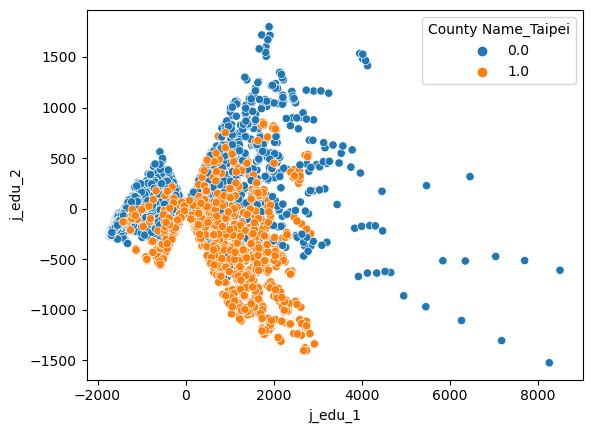

In [31]:
df['j_edu2_slope'] = df['j_edu_2']/df['j_edu_1']
sns.scatterplot(data=df[df['j_edu2_slope'].between(-1,1)], x='j_edu_1', y='j_edu_2',hue='County Name_Taipei')

In [26]:
df[['j_edu_1', 'j_edu_2', 'j_edu2_slope']]

,j_edu_1,j_edu_2,j_edu2_slope
0,-1645.484882,-258.236137,0.156936
1,-549.302955,269.368462,-0.490382
2,240.064416,749.843793,3.123511
3,-337.370205,391.182008,-1.159504
4,-1461.841788,-33.339026,0.022806
...,...,...,...
7435,420.085351,375.411746,0.893656
7436,88.200951,82.758909,0.938300
7437,485.725894,480.809777,0.989879
7438,1149.716394,362.883417,0.315629


<AxesSubplot:xlabel='j_edu_1', ylabel='j_edu_2'>

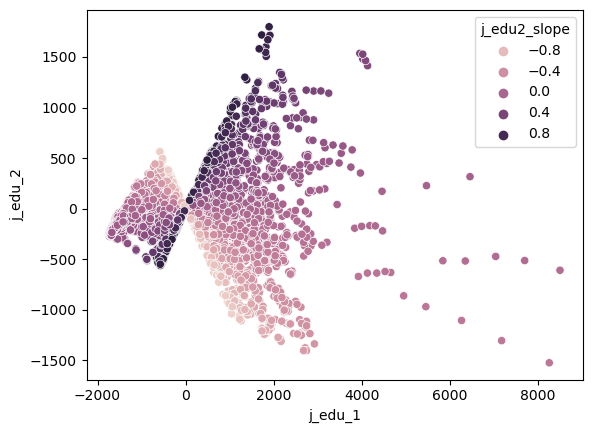

In [32]:
sns.scatterplot(data=df[df['j_edu2_slope'].between(-1,1)], x='j_edu_1', y='j_edu_2',hue='j_edu2_slope')

# other pca scatter plot

c_pop_


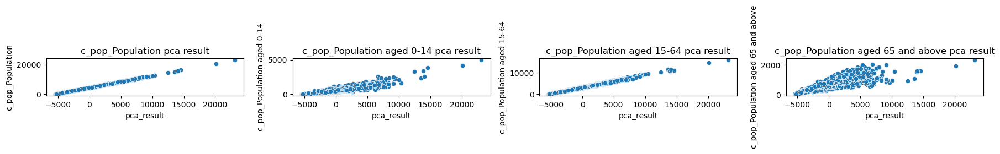

h_Median


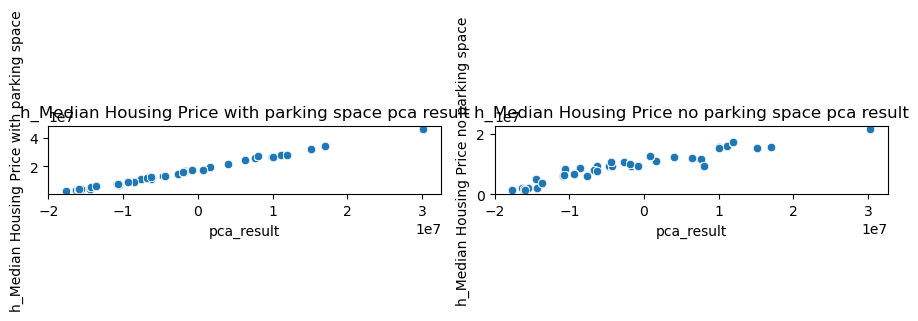

j_income


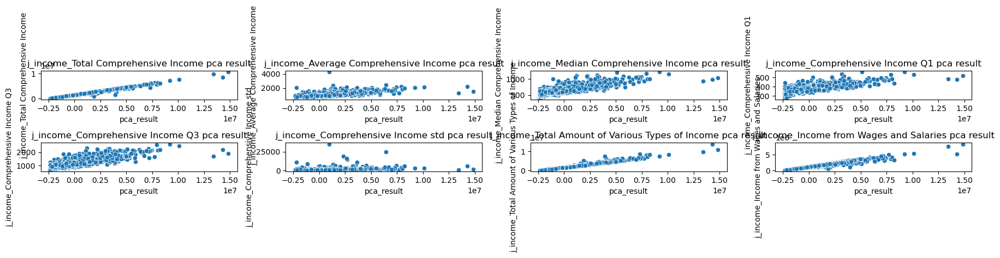

c_marrital


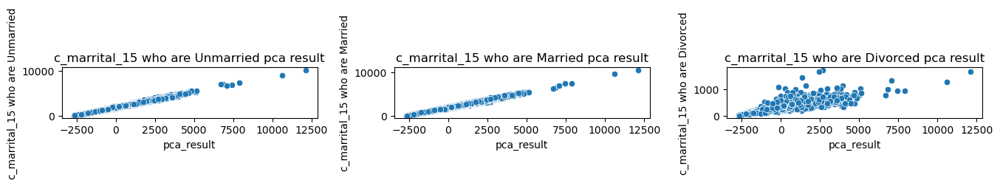

c_ratio


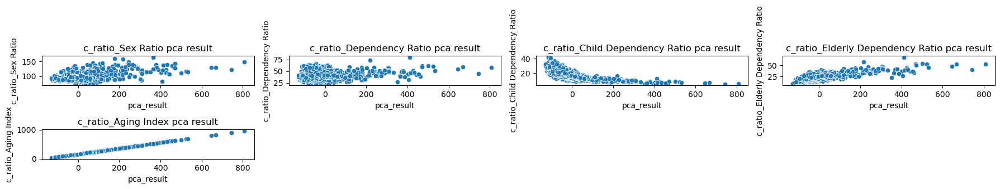

c_pop_


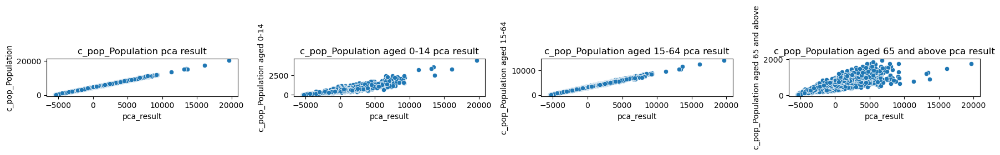

h_Median


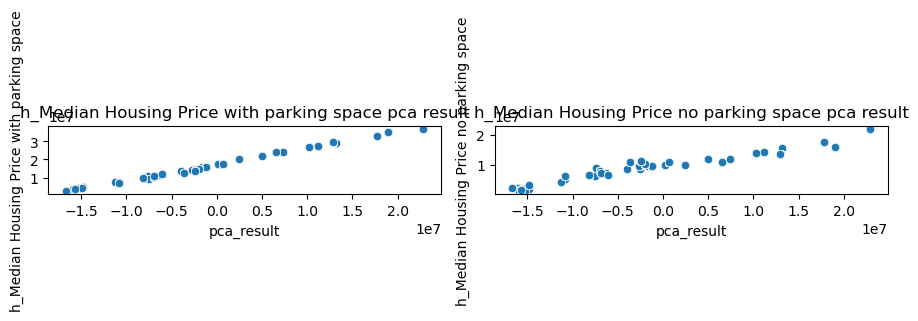

j_income


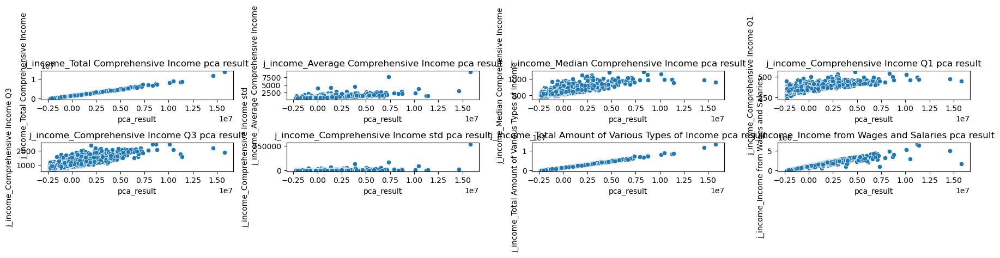

c_marrital


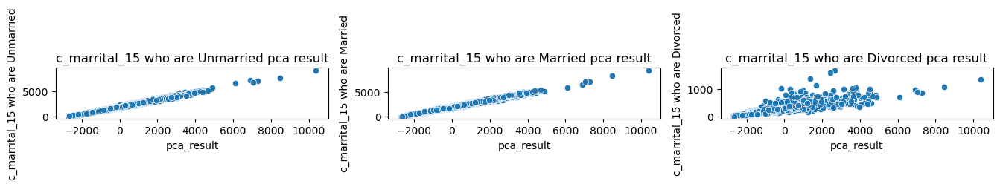

c_ratio


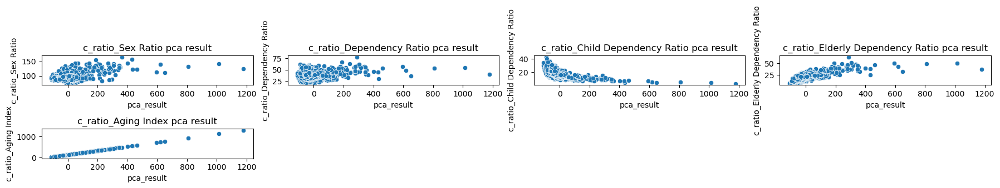

c_pop_


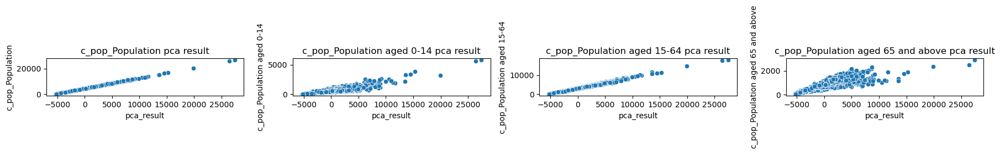

h_Median


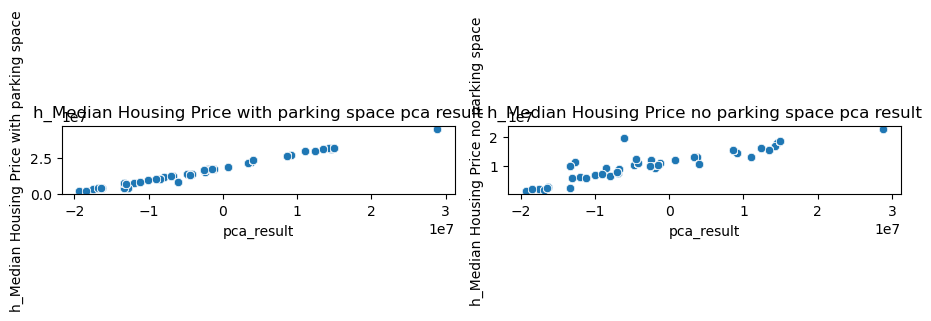

j_income


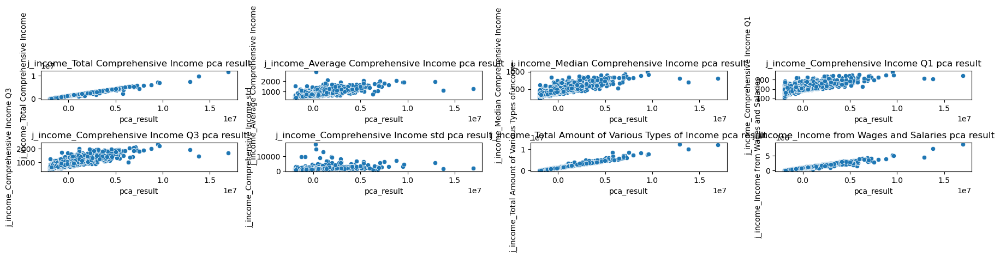

c_marrital


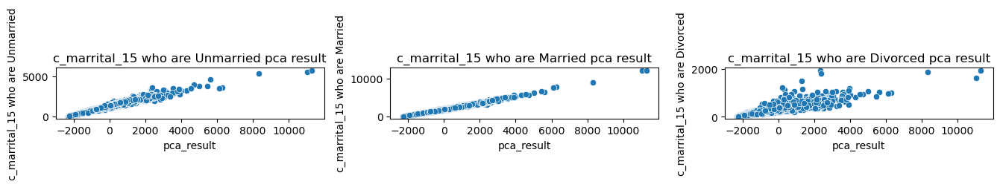

c_ratio


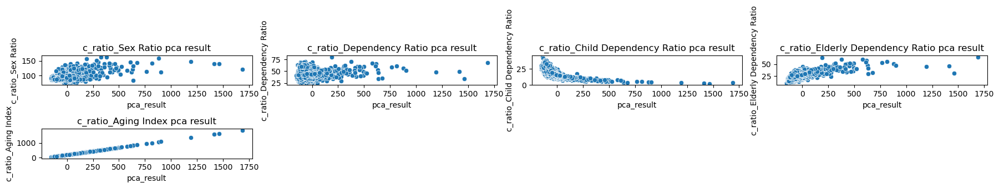

c_pop_


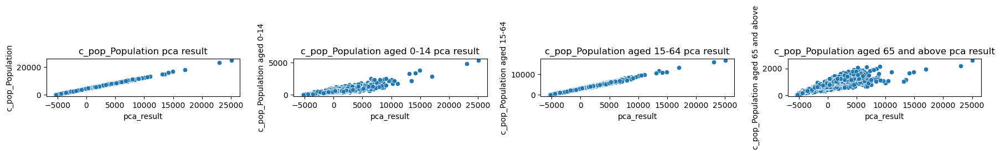

h_Median


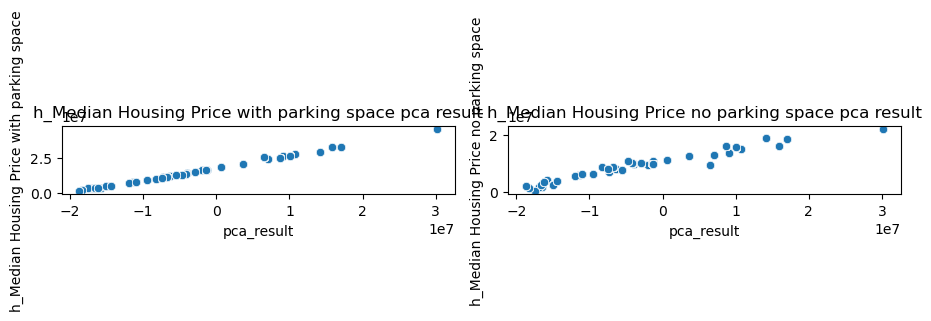

j_income


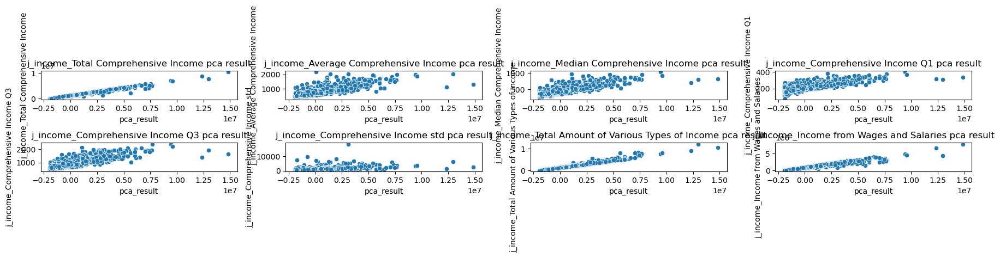

c_marrital


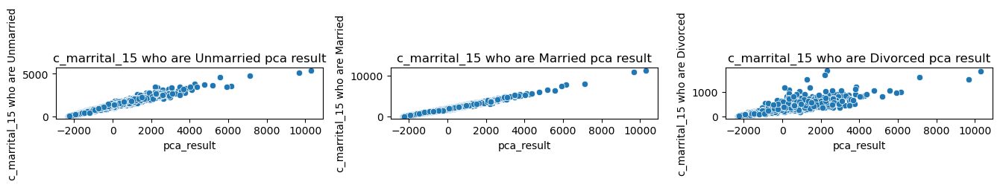

c_ratio


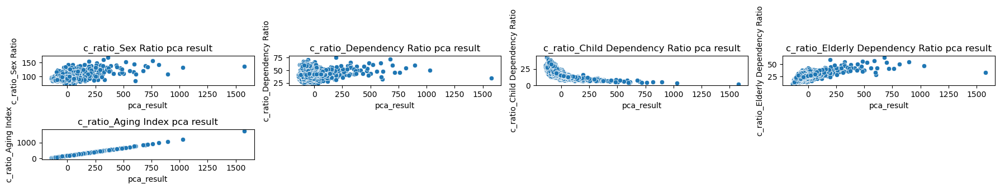

c_pop_


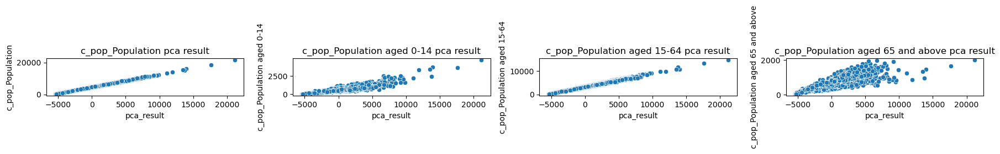

h_Median


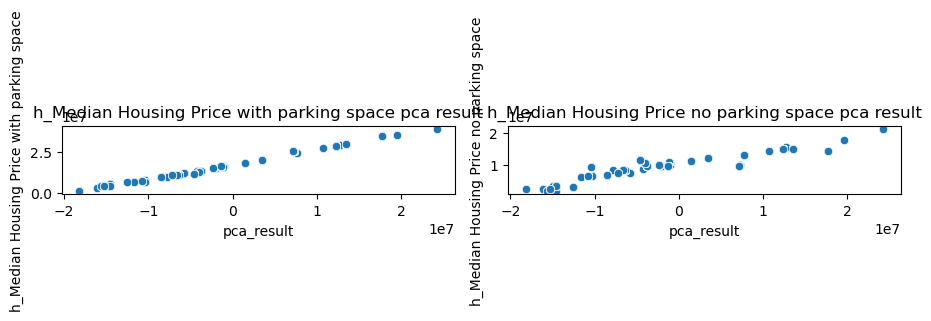

j_income


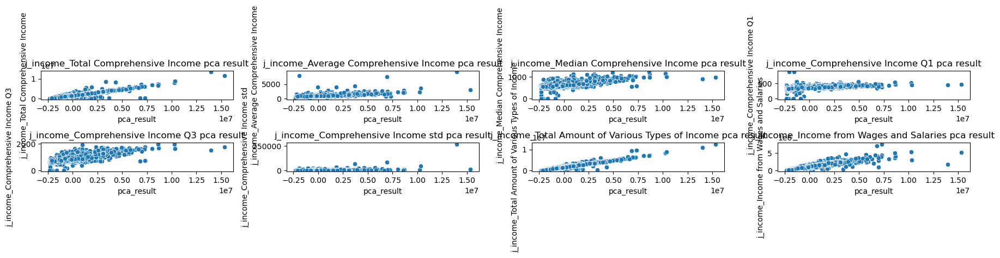

c_marrital


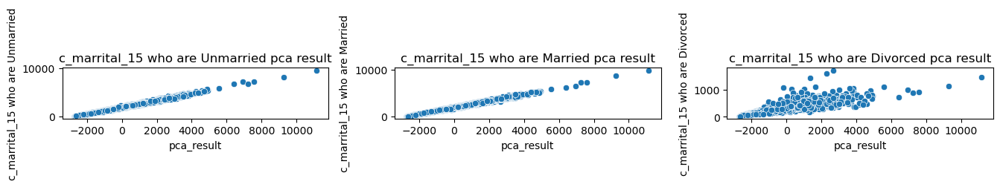

c_ratio


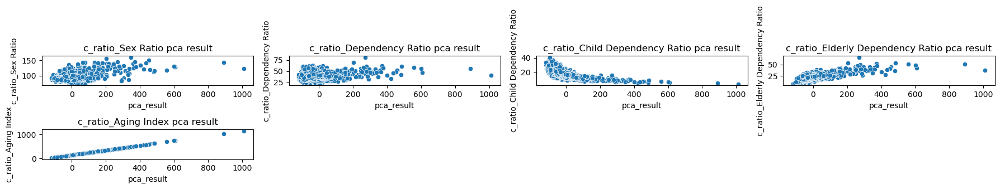

In [79]:
reg = {'c_pop_':1, 'h_Median':1, 'j_income':1, 'c_marrital':1, 'c_ratio':1}
for i in [107, 105, 109, 108, 106]:
    for key in reg:
        print(key)
        x = df[df['Year']==i].filter(regex=key)
        pca = PCA(reg[key]).fit(x)
        plotsct(x, i, name)

In [8]:
df = df.drop(columns=['c_popcal_Total Number of Households', 'c_pop', 'c_ratio'])

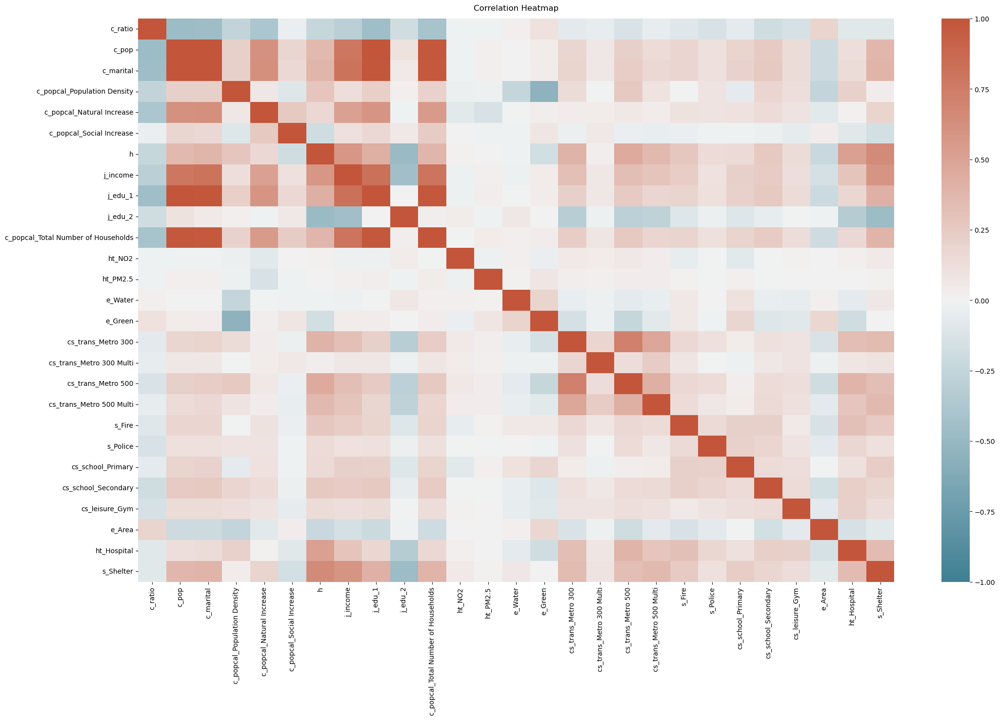

In [13]:
plt.figure(figsize=(25, 15))

heatmap = sns.heatmap(df.iloc[:, 4:31].corr(), vmin=-1, vmax=1, annot=False, cmap=sns.diverging_palette(220, 20, as_cmap=True))

heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':12}, pad=12);

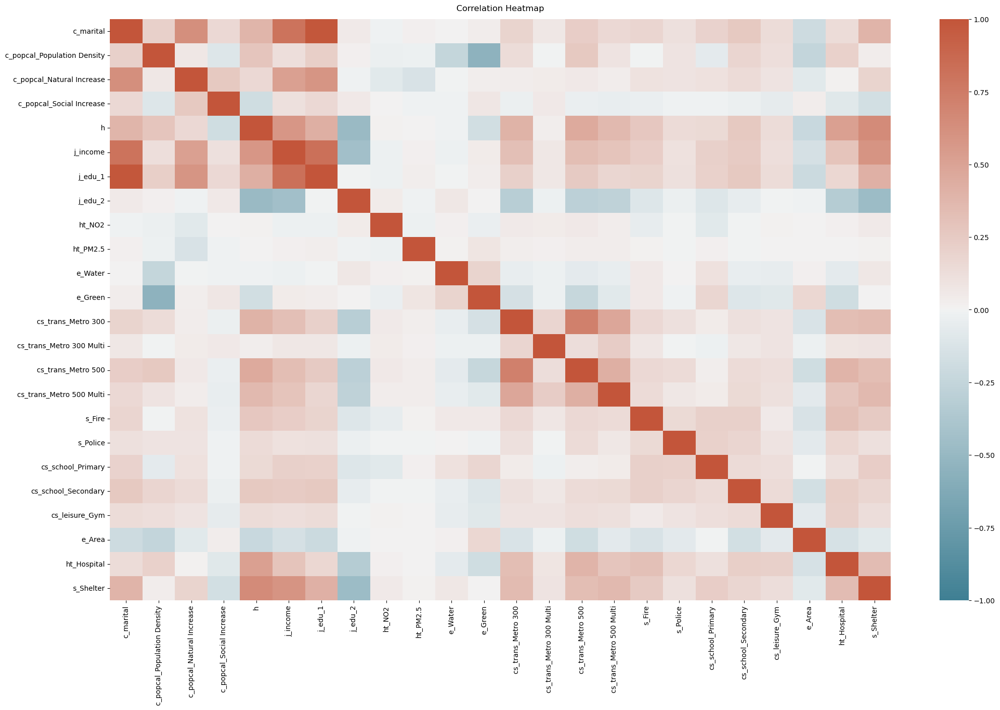

In [9]:
plt.figure(figsize=(25, 15))

heatmap = sns.heatmap(df.iloc[:, 4:28].corr(), vmin=-1, vmax=1, annot=False, cmap=sns.diverging_palette(220, 20, as_cmap=True))

heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':12}, pad=12);

C:\Users\jigme\anaconda3\lib\site-packages\seaborn\utils.py:95: UserWarning: Glyph 19977 (\N{CJK UNIFIED IDEOGRAPH-4E09}) missing from current font.
  fig.canvas.draw()
C:\Users\jigme\anaconda3\lib\site-packages\seaborn\utils.py:95: UserWarning: Glyph 33437 (\N{CJK UNIFIED IDEOGRAPH-829D}) missing from current font.
  fig.canvas.draw()
C:\Users\jigme\anaconda3\lib\site-packages\seaborn\utils.py:95: UserWarning: Glyph 21312 (\N{CJK UNIFIED IDEOGRAPH-5340}) missing from current font.
  fig.canvas.draw()
C:\Users\jigme\anaconda3\lib\site-packages\seaborn\utils.py:95: UserWarning: Glyph 20013 (\N{CJK UNIFIED IDEOGRAPH-4E2D}) missing from current font.
  fig.canvas.draw()
C:\Users\jigme\anaconda3\lib\site-packages\seaborn\utils.py:95: UserWarning: Glyph 21644 (\N{CJK UNIFIED IDEOGRAPH-548C}) missing from current font.
  fig.canvas.draw()
C:\Users\jigme\anaconda3\lib\site-packages\seaborn\utils.py:95: UserWarning: Glyph 20843 (\N{CJK UNIFIED IDEOGRAPH-516B}) missing from current font.
  fig.

C:\Users\jigme\anaconda3\lib\site-packages\IPython\core\pylabtools.py:151: UserWarning: Glyph 26494 (\N{CJK UNIFIED IDEOGRAPH-677E}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


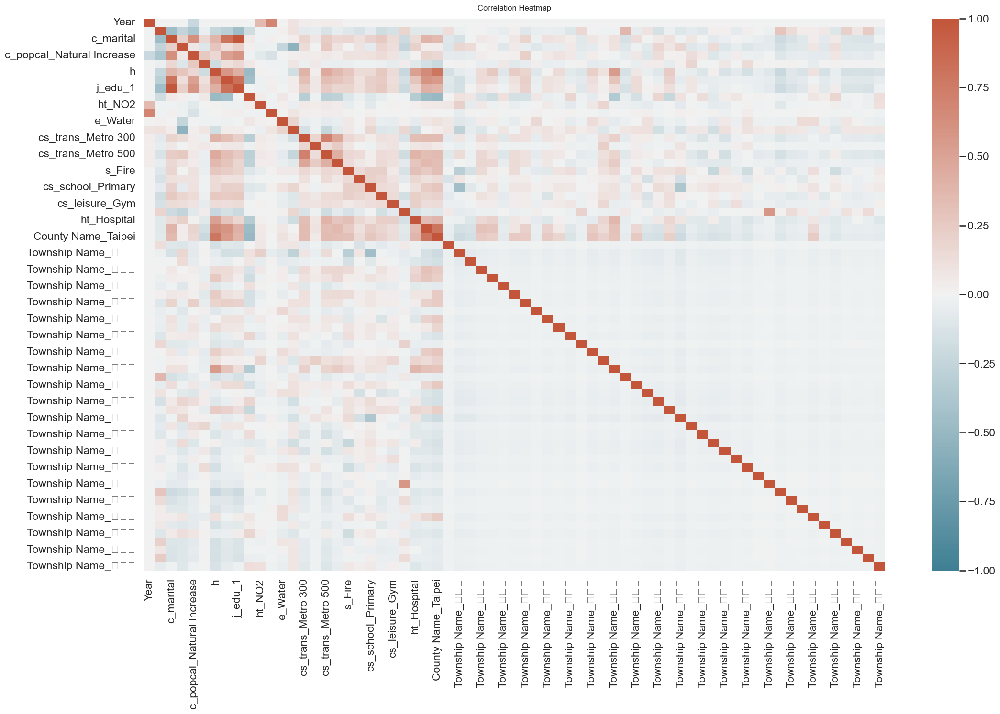

In [178]:
plt.figure(figsize=(25, 15))

heatmap = sns.heatmap(df.corr(), vmin=-1, vmax=1, annot=False, cmap=sns.diverging_palette(220, 20, as_cmap=True))

heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':12}, pad=12);

## Marital & Education?

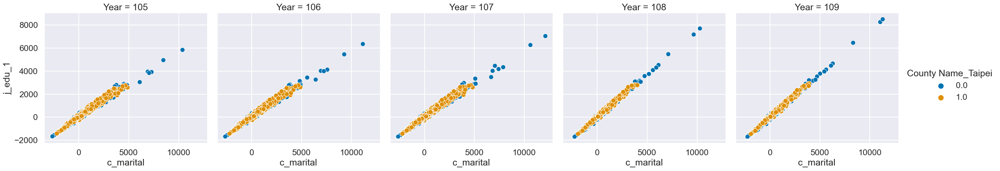

In [192]:
sns.relplot(data=df, x="c_marital", y="j_edu_1", hue="County Name_Taipei", col="Year")

<AxesSubplot:xlabel='c_marital', ylabel='j_edu_2'>

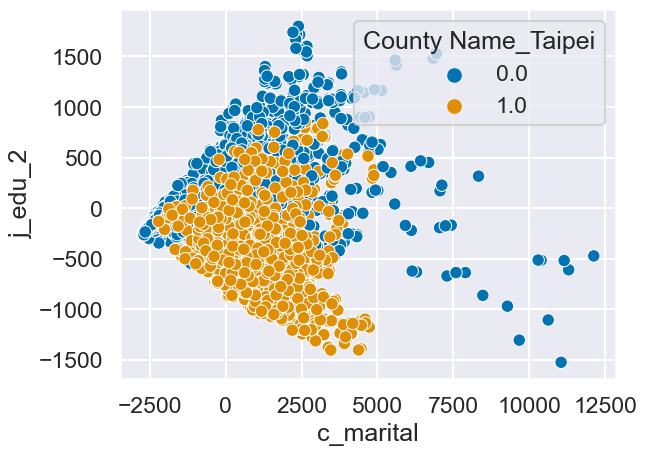

In [181]:
sns.scatterplot(data=df, x="c_marital", y="j_edu_2", hue="County Name_Taipei")

<AxesSubplot:xlabel='c_marital', ylabel='j_edu_2'>

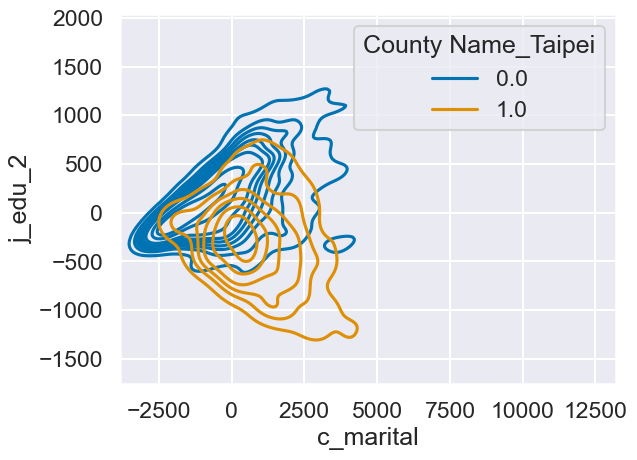

In [182]:
sns.kdeplot(data=df, x="c_marital", y="j_edu_2", hue="County Name_Taipei")

## Income & Education

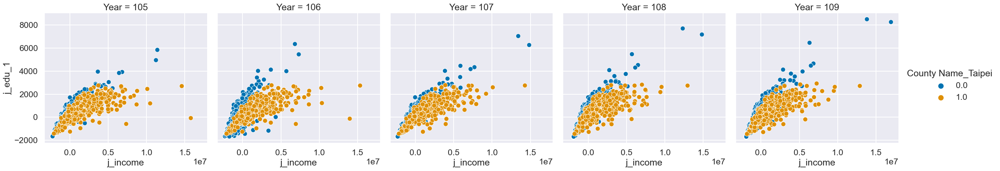

In [272]:
sns.relplot(data=df, x="j_income", y="j_edu_1", hue="County Name_Taipei", col="Year")

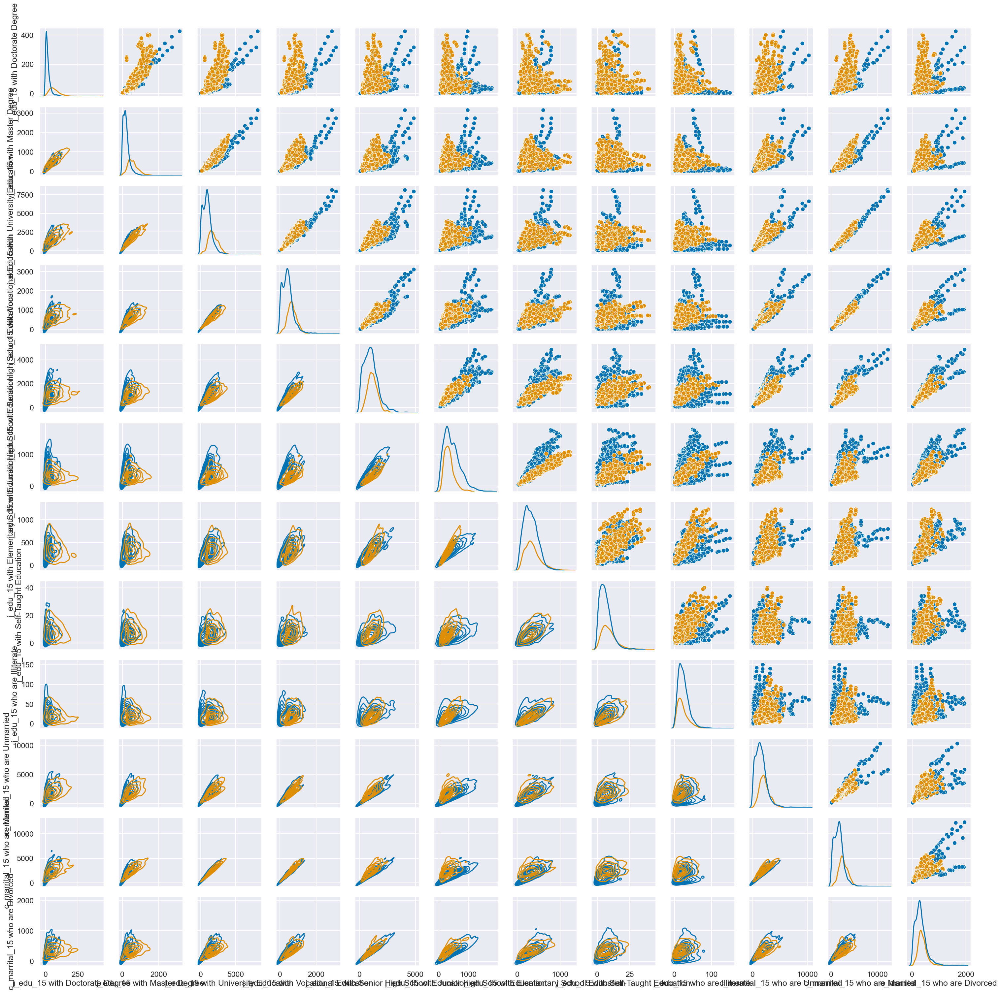

In [190]:
eduNmari = temp.filter(regex='edu|marrital|County Name_Taipei')
g = sns.PairGrid(eduNmari, diag_sharey=False, hue="County Name_Taipei")
g.map_upper(sns.scatterplot)
g.map_lower(sns.kdeplot)
g.map_diag(sns.kdeplot)

### 婚姻和高等教育正相關，義務教育無關

C:\Users\jigme\AppData\Local\Temp\ipykernel_14476\1492848030.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  eduYear['c_marital'] = df['c_marital']


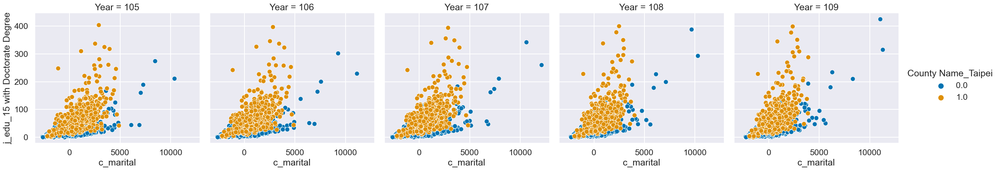

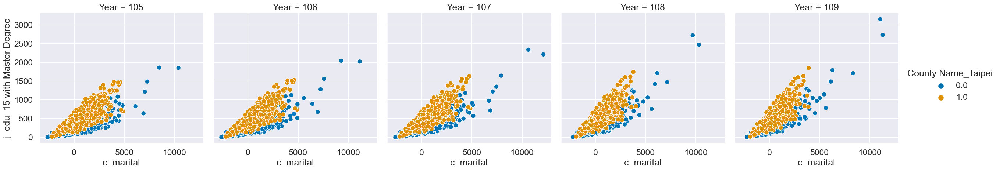

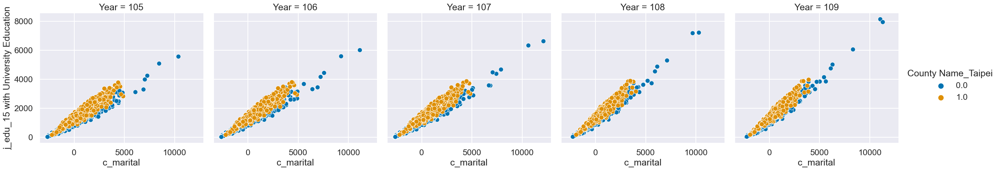

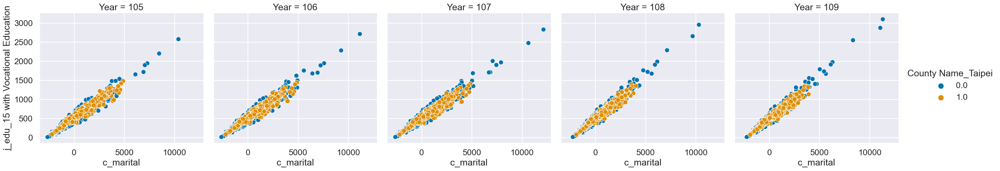

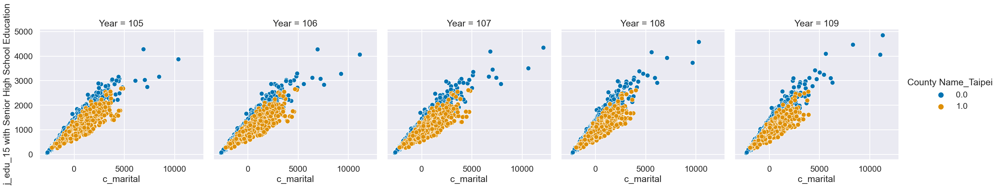

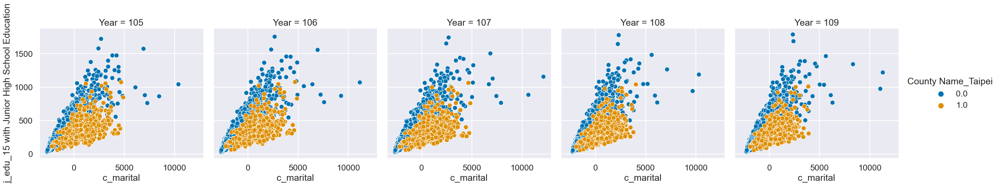

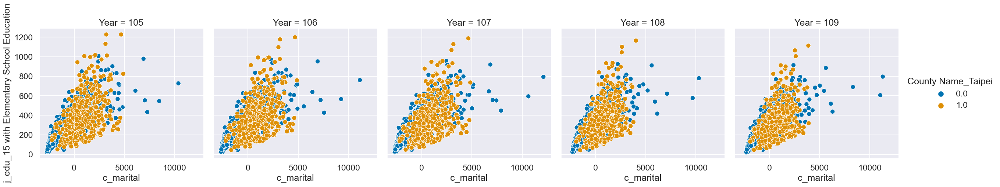

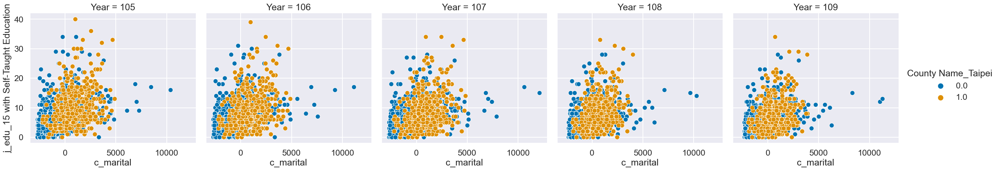

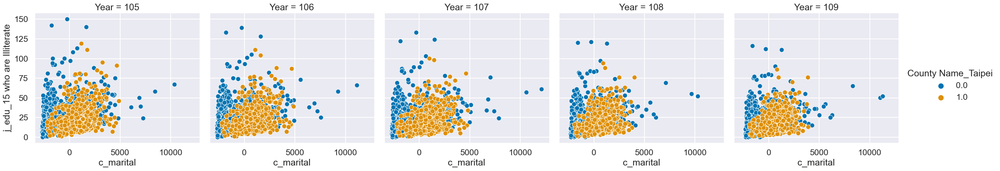

In [193]:
eduYear = temp.filter(regex='edu|County Name_Taipei|Year')
eduYear['c_marital'] = df['c_marital']
for i in eduYear.filter(regex='edu').columns:
    sns.relplot(data=eduYear, x="c_marital", y=i, hue="County Name_Taipei", col="Year")    

C:\Users\jigme\AppData\Local\Temp\ipykernel_14476\2719185050.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  eduYear['j_income'] = df['j_income']


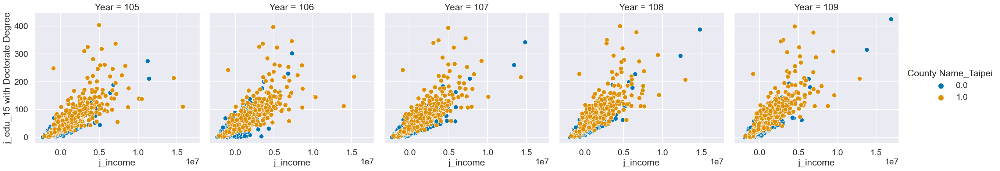

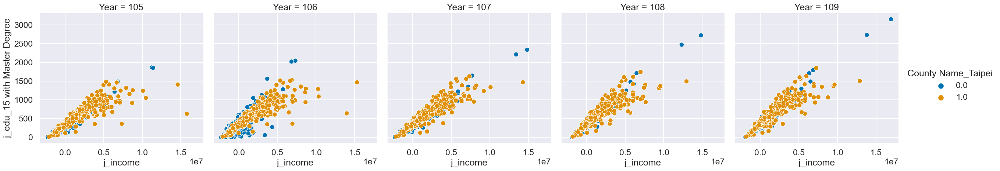

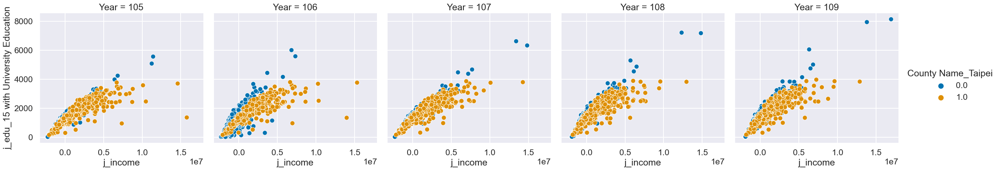

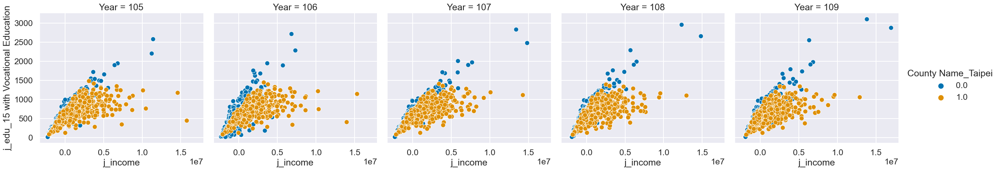

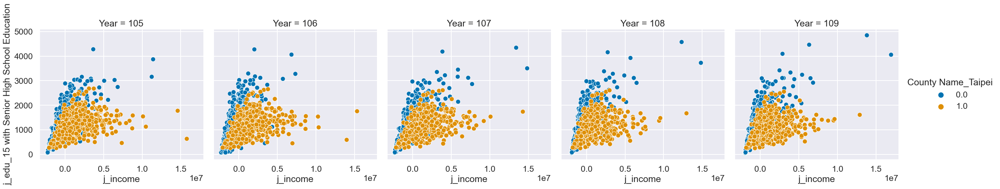

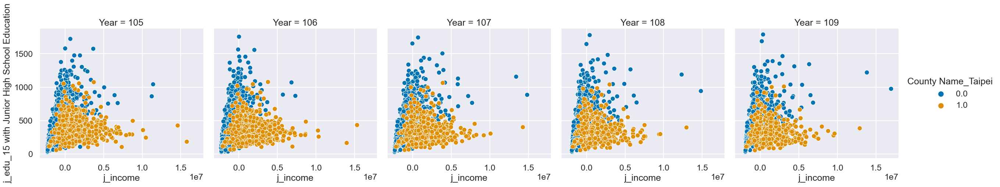

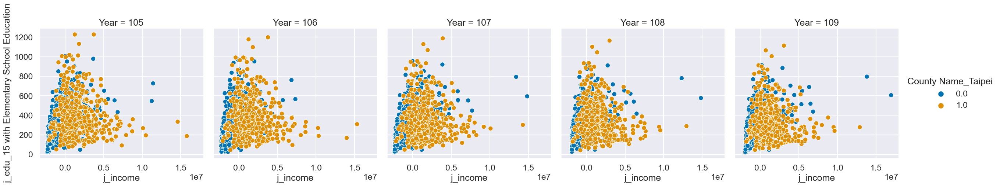

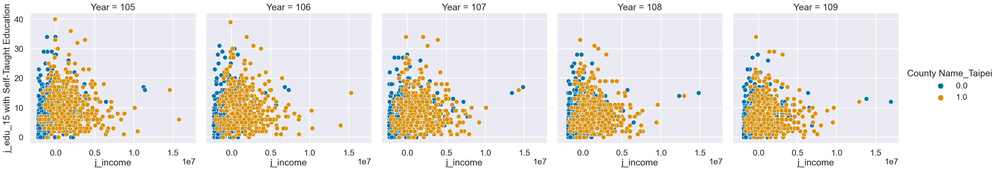

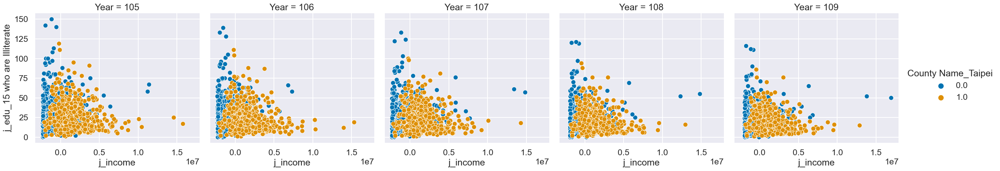

In [195]:
eduYear = temp.filter(regex='edu|County Name_Taipei|Year')
eduYear['j_income'] = df['j_income']
for i in eduYear.filter(regex='edu').columns:
    sns.relplot(data=eduYear, x="j_income", y=i, hue="County Name_Taipei", col="Year")    

C:\Users\jigme\AppData\Local\Temp\ipykernel_14476\3193074419.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  eduYear['j_edu_1'] = df['j_edu_1']


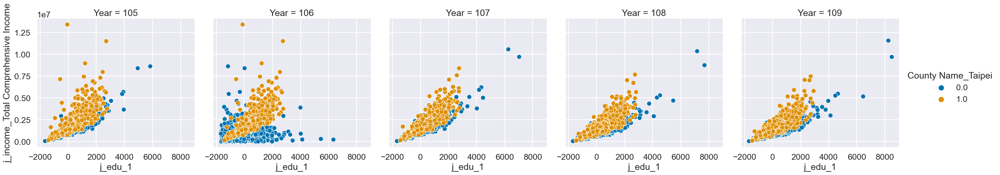

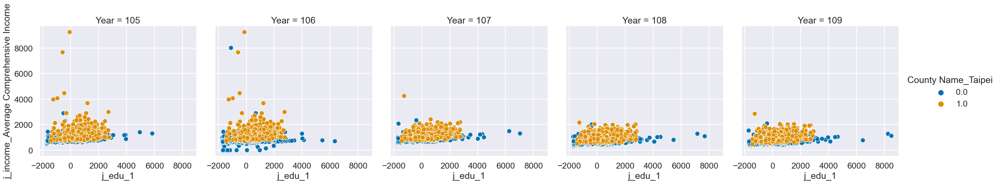

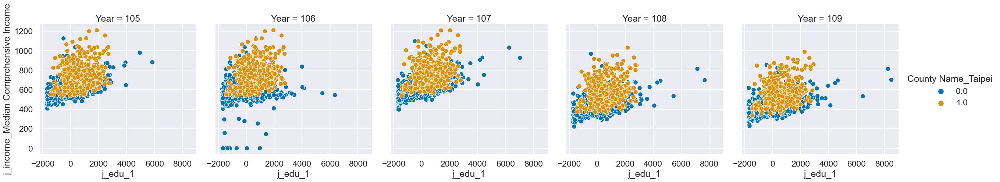

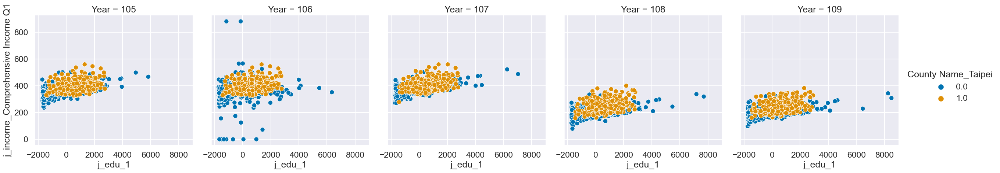

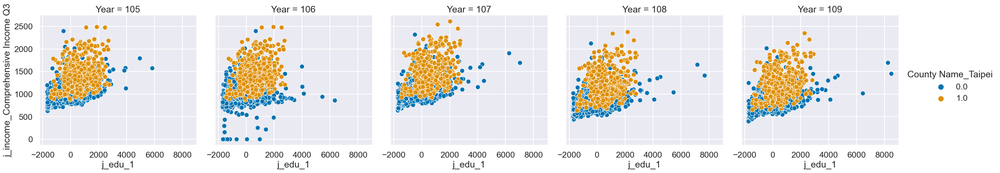

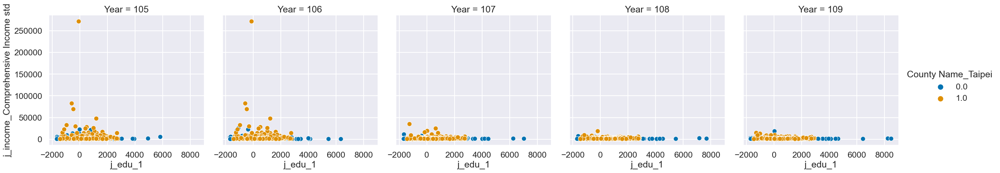

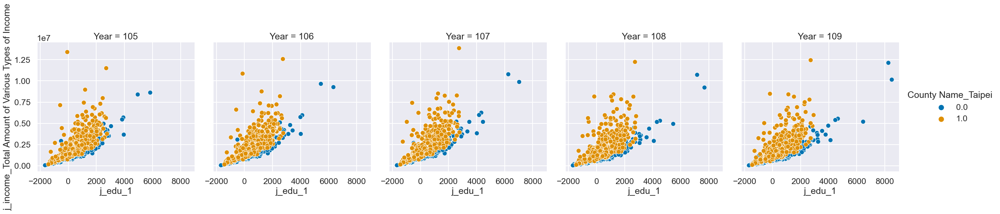

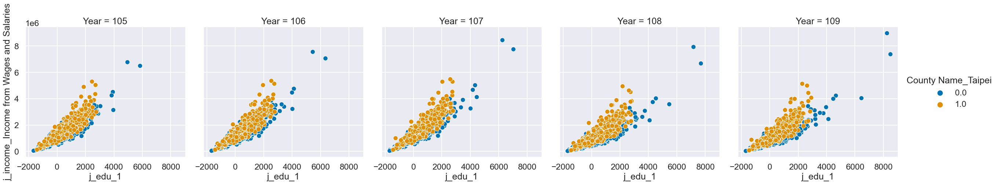

In [196]:
eduYear = temp.filter(regex='income|County Name_Taipei|Year')
eduYear['j_edu_1'] = df['j_edu_1']
for i in eduYear.filter(regex='income').columns:
    sns.relplot(data=eduYear, x="j_edu_1", y=i, hue="County Name_Taipei", col="Year")    

C:\Users\jigme\AppData\Local\Temp\ipykernel_14476\4016819991.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  eduYear['j_edu_2'] = df['j_edu_2']


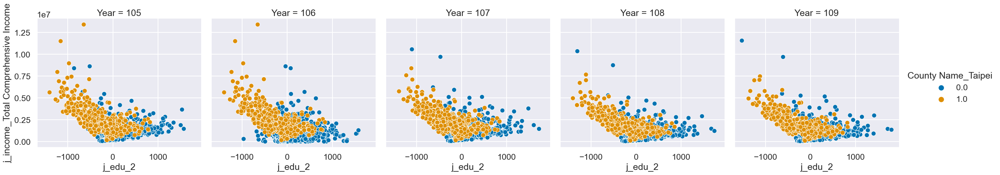

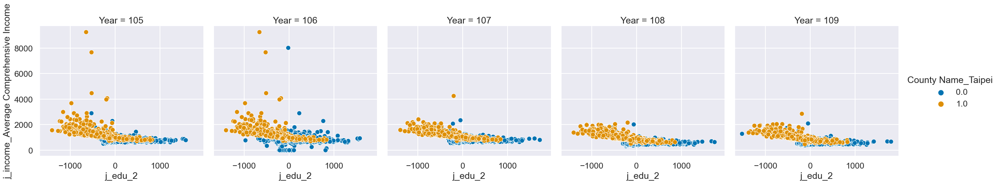

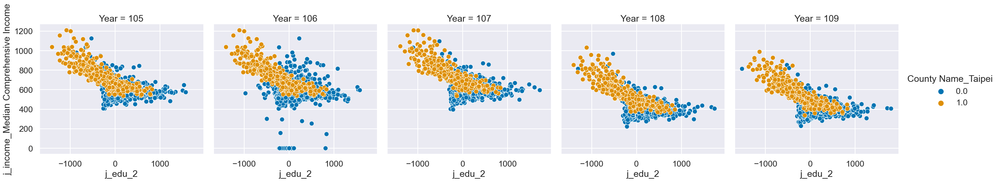

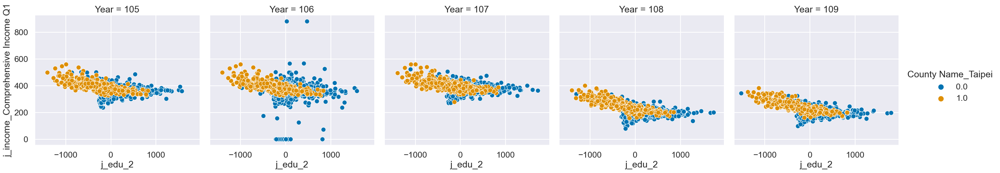

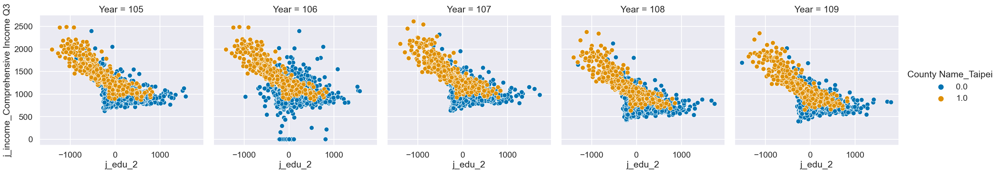

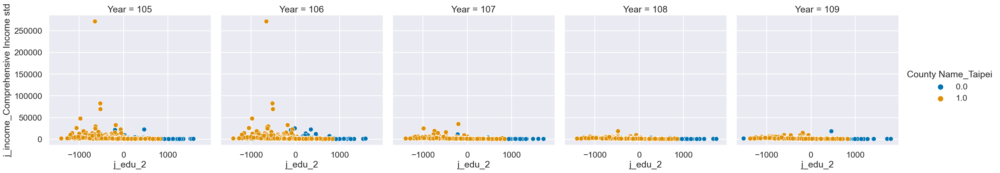

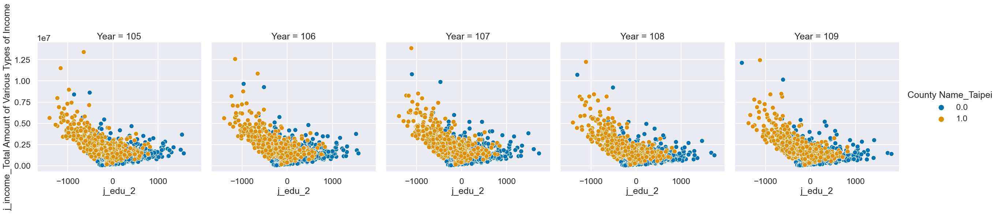

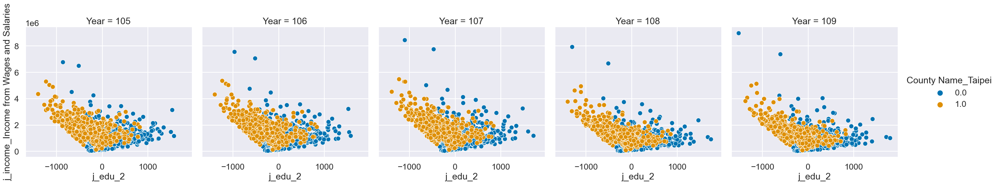

In [197]:
eduYear = temp.filter(regex='income|County Name_Taipei|Year')
eduYear['j_edu_2'] = df['j_edu_2']
for i in eduYear.filter(regex='income').columns:
    sns.relplot(data=eduYear, x="j_edu_2", y=i, hue="County Name_Taipei", col="Year")    

### 所得和高等教育呈正相關，義務教育略無關

C:\Users\jigme\AppData\Local\Temp\ipykernel_14476\4237234476.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  eduYear['j_edu_2'] = df['j_edu_2']


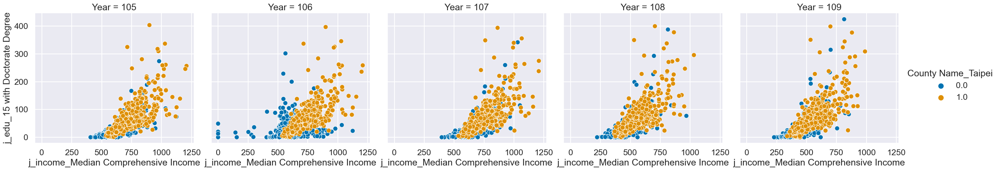

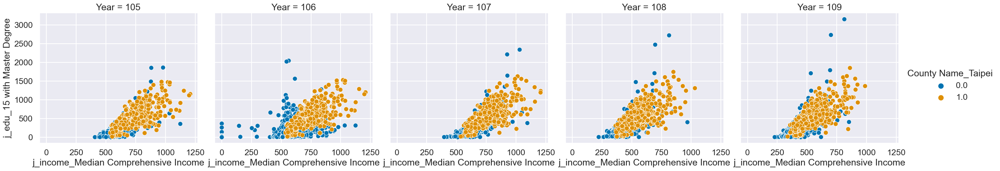

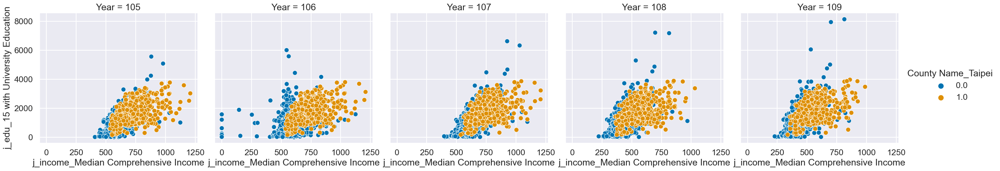

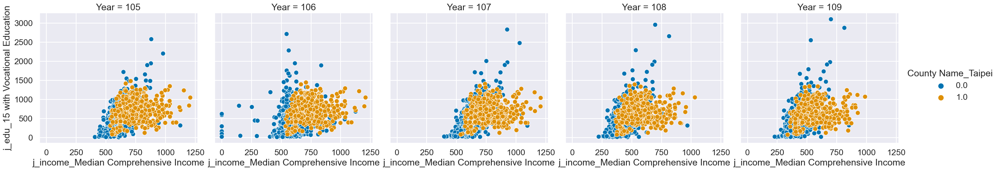

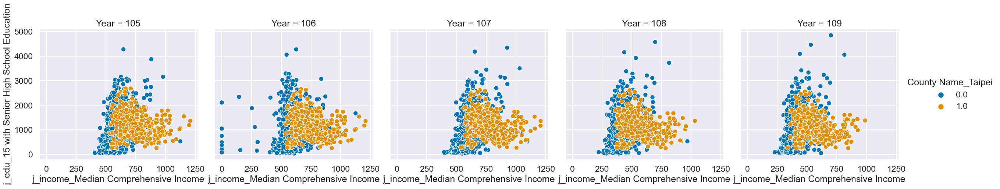

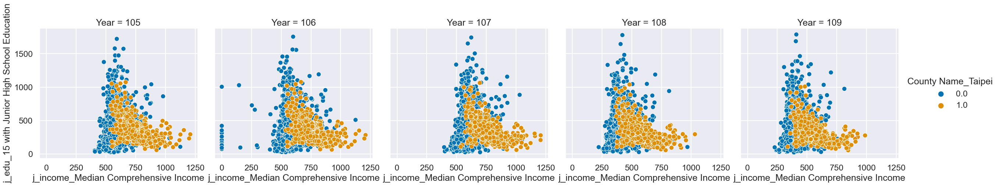

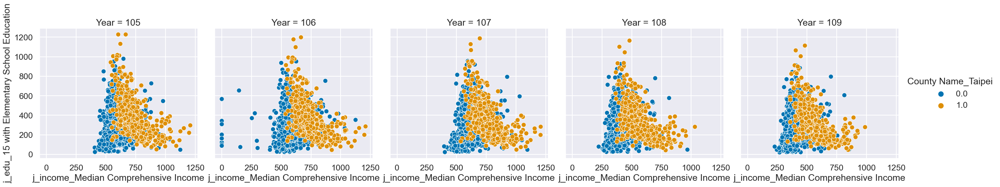

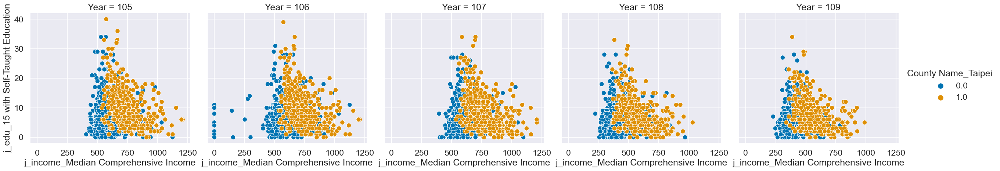

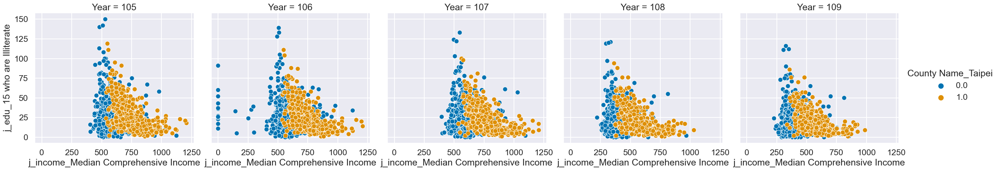

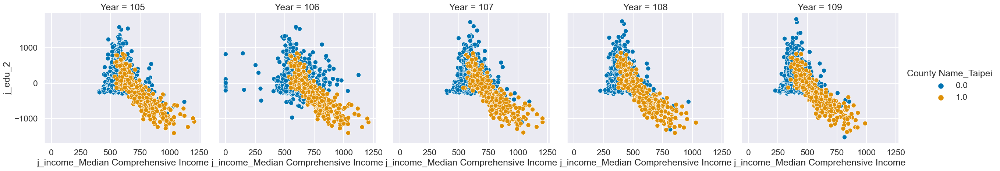

In [199]:
eduYear = temp.filter(regex='income|County Name_Taipei|Year|edu')
eduYear['j_edu_2'] = df['j_edu_2']
for i in eduYear.filter(regex='edu').columns:
    sns.relplot(data=eduYear, x="j_income_Median Comprehensive Income", y=i, hue="County Name_Taipei", col="Year")    

## transform

In [452]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7440 entries, 0 to 7439
Data columns (total 69 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   Year                         7440 non-null   int64  
 1   County Name                  7440 non-null   object 
 2   Township Name                7440 non-null   object 
 3   Village Name                 7440 non-null   object 
 4   c_marital                    7440 non-null   float64
 5   c_popcal_Population Density  7440 non-null   float64
 6   c_popcal_Natural Increase    7440 non-null   int64  
 7   c_popcal_Social Increase     7440 non-null   int64  
 8   h                            7440 non-null   float64
 9   j_income                     7440 non-null   float64
 10  j_edu_1                      7440 non-null   float64
 11  j_edu_2                      7440 non-null   float64
 12  ht_NO2                       7440 non-null   float64
 13  ht_PM2.5          

In [453]:
shp = pd.read_csv('toshp.csv', encoding='utf-8')
shp = shp.set_index(shp[['COUNTY', 'TOWN', 'VILLAGE']].apply(
        lambda x: "".join(x.astype(str)), axis=1))
shp.index.rename('index', inplace=True)

In [454]:
df = df.set_index(df[['County Name', 'Township Name', 'Village Name']].apply(
        lambda x: "".join(x.astype(str)), axis=1))
df.index.rename('index', inplace=True)
df = df.join(shp['V_ID'], on='index')

In [455]:
from scipy import stats
from sklearn.preprocessing import MinMaxScaler
    
for i in range(105,110):
    # minmax scale
    dfyear = df[df['Year']==i]
    scaler = MinMaxScaler()
    dfyear.iloc[:,np.r_[4:28]] = scaler.fit_transform(dfyear.iloc[:,np.r_[4:28]])
    
    # box-cox trans
    for j in dfyear.columns[4:14]:

        dftemp = dfyear[j]
        dft, _ = stats.boxcox(dftemp+1)
        dfyear[j] = dft
        if j == 'j_edu_2':
            dftemp = dfyear['e_Area']
            dft, _ = stats.boxcox(dftemp+1)
            dfyear['e_Area'] = dft
            
    dfyear.to_csv('train'+str(i)+'.csv')

C:\Users\jigme\AppData\Local\Temp\ipykernel_14476\2305518200.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dfyear.iloc[:,np.r_[4:28]] = scaler.fit_transform(dfyear.iloc[:,np.r_[4:28]])
C:\Users\jigme\AppData\Local\Temp\ipykernel_14476\2305518200.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dfyear[j] = dft
C:\Users\jigme\AppData\Local\Temp\ipykernel_14476\2305518200.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_